In [1]:
%load_ext autoreload
%reload_ext autoreload
%autoreload 2

% matplotlib inline
from __future__ import (division, 
                        print_function)

import os
import re
import sys
import copy
import glob
import fnmatch
import warnings
import itertools
import collections

import numpy as np
import scipy
try:
    from scipy.stats import scoreatpercentile
except:
    scoreatpercentile = False
from scipy.interpolate import interp1d
import cPickle as pickle
from scipy import ndimage

# Astropy
from astropy.io import fits
from astropy    import units as u
from astropy.stats import sigma_clip
from astropy.table import Table, Column
from astropy.utils.console import ProgressBar
from astropy.convolution import convolve, Box1DKernel

# AstroML
from astroML.plotting import hist
from astroML.density_estimation import KNeighborsDensity
try:
    from sklearn.neighbors import KernelDensity
    use_sklearn_KDE = True
except:
    import warnings
    warnings.warn("KDE will be removed in astroML version 0.3.  Please "
                  "upgrade to scikit-learn 0.14+ and use "
                  "sklearn.neighbors.KernelDensity.", DeprecationWarning)
    from astroML.density_estimation import KDE
    use_sklearn_KDE = False
from sklearn.neighbors import KDTree
from sklearn.neighbors import BallTree

# Matplotlib related
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.style.use('classic')
import matplotlib.patches as mpatches
import matplotlib.gridspec as gridspec
from matplotlib.patches import Ellipse
from matplotlib.ticker import NullFormatter, MaxNLocator, FormatStrFormatter
from matplotlib.collections import PatchCollection
tickFormat = FormatStrFormatter('$\mathbf{%g}$') 

# Cosmology
import cosmology
c=cosmology.Cosmo(H0=70.0, omega_m=0.3, omega_l=0.7, flat=1)

# SEP 
import sep

# Color map 
from palettable.colorbrewer.sequential import Greys_9, OrRd_9, Blues_9, Purples_9, YlGn_9
BLK = Greys_9.mpl_colormap
ORG = OrRd_9.mpl_colormap
BLU = Blues_9.mpl_colormap
GRN = YlGn_9.mpl_colormap
PUR = Purples_9.mpl_colormap

# Personal tools
import galSBP
import hscUtils as hUtil
from hscUtils import songPlotSetup, removeIsNullCol
from hscUtils import confidence_interval, ma_confidence_interval_1d, confidence_interval_1d

## Constants
# SDSS pivot wavelength 
sdss_u_pivot = 3551.0
sdss_g_pivot = 4686.0
sdss_r_pivot = 6165.0
sdss_i_pivot = 7481.0
sdss_z_pivot = 8931.0

# HSC pivot wavelength 
hsc_g_pivot = 4782.2
hsc_r_pivot = 6101.7 
hsc_i_pivot = 7648.0 
hsc_z_pivot = 8883.0
hsc_y_pivot = 9750.8

hscFiltWave = np.asarray([hsc_g_pivot, hsc_r_pivot, hsc_i_pivot, hsc_z_pivot, hsc_y_pivot])

"""
Absolute magnitude of the Sun in HSC filters
Right now, just use the DES filters
"""
SUN_G = 5.08
SUN_R = 4.62
SUN_I = 4.52
SUN_Z = 4.52
SUN_Y = 4.51

# Solar stellar metallicity 
Z_SUN = 0.02

# definitions for the axes
left, width    = 0.15, 0.64
right          = left + width 
bottom, height = 0.13, 0.86
bottom_h = left_h = left + width + 0.02
recScat = [left,   bottom, width, height]
recHist = [right,  bottom,  0.20, height]
SBP1 = [0.124, 0.085, 0.865, 0.33]
SBP2 = [0.124, 0.41, 0.865, 0.55]
EC1 = [0.135, 0.072, 0.862, 0.295]
EC2 = [0.135, 0.366, 0.862, 0.295]
EC3 = [0.135, 0.666, 0.862, 0.295]
REC = [0.12, 0.11, 0.87, 0.87]
COG1 = [0.143, 0.10, 0.850, 0.43]
COG2 = [0.143, 0.53, 0.850, 0.43]

# Universal RSMA array
RSMA_COMMON = np.arange(0.4, 4.2, 0.01)
RR50_COMMON = np.arange(0.0, 9.0, 0.01)
EMPTY = (RSMA_COMMON * np.nan)

# Color 
BLUE0 = "#92c5de"
BLUE1 = "#0571b0"
RED0 = "#f4a582"
RED1 = "#ca0020"
PURPLE0 = '#af8dc3'
PURPLE1 = '#762a83'
BROWN0 = '#bf812d'
BROWN1 = '#543005'
GREEN0 = '#7fbf7b'
GREEN1 = '#1b7837'

# 3-sigma
SIGMA1 = 0.3173
SIGMA2 = 0.0455
SIGMA3 = 0.0027


# Cubehelix
from palettable.cubehelix import Cubehelix
CUBE = Cubehelix.make(start=0.3, rotation=-0.5, n=16).mpl_colormap

In [2]:
def loadPkl(filename):
    try:
        import cPickle as pickle
    except:
        warnings.warn("## cPickle is not available!!")
        import pickle
    
    if os.path.isfile(filename):
        pklFile = open(filename, 'rb')
        data = pickle.load(pklFile)    
        pklFile.close()
    
        return data
    else: 
        warnings.warn("## Can not find %s, return None" % filename)
        return None

In [3]:
#isophote = '/iraf/iraf/extern/stsdas/bin.macosx/x_isophote.e'
#xttools = '/iraf/iraf/extern/tables/bin.macosx/x_ttools.e'
isophote = '/Users/song/anaconda/pkgs/iraf-2.16.1-0/variants/common/iraf/stsci_iraf/stsdas/bin.macosx/x_isophote.e'
xttools = '/Users/song/anaconda/pkgs/iraf-2.16.1-0/variants/common/iraf/stsci_iraf/tables/bin.macosx/x_ttools.e'

# The Gaussian kernal used for convolution
kernel1 = np.asarray([[0.560000, 0.980000, 0.560000],
                      [0.980000, 1.000000, 0.980000],
                      [0.560000, 0.980000, 0.560000]])

kernel2 = np.asarray([[0.000000, 0.220000, 0.480000, 0.220000, 0.000000],
                      [0.220000, 0.990000, 1.000000, 0.990000, 0.220000],
                      [0.480000, 1.000000, 1.000000, 1.000000, 0.480000],
                      [0.220000, 0.990000, 1.000000, 0.990000, 0.220000],
                      [0.000000, 0.220000, 0.480000, 0.220000, 0.000000]])

kernel3 = np.asarray([[0.092163, 0.221178, 0.296069, 0.221178, 0.092163],
                      [0.221178, 0.530797, 0.710525, 0.530797, 0.221178],
                      [0.296069, 0.710525, 0.951108, 0.710525, 0.296069],
                      [0.221178, 0.530797, 0.710525, 0.530797, 0.221178],
                      [0.092163, 0.221178, 0.296069, 0.221178, 0.092163]])

# Catalog and File Names

In [4]:
h0 = 0.7
h0square = h0 ** 2.0
redshift = 0.3

scale = (1.85 / h0) / (1.0 + redshift) # kpc
print(scale)

cenX, cenY = 81.0, 81.0

2.03296703297


In [5]:
imgDir = 'maps'
msDir = os.path.join(imgDir, 'stellar_central')
mhDir = os.path.join(imgDir, 'stellar_halo')
mdDir = os.path.join(imgDir, 'darkmatter_halo')
mgDir = os.path.join(imgDir, 'gas_halo')

msList = glob.glob(msDir + '/*.fits')
mhList = glob.glob(mhDir + '/*.fits')
mdList = glob.glob(mdDir + '/*.fits')
mgList = glob.glob(mgDir + '/*.fits')

sampleSize = len(mhList)
print(sampleSize)
print(sampleSize / 7)

nSample = 291

291
41.5714285714


In [6]:
# Examples 
imgExample = fits.open(msList[0])[0].data
headExample = fits.open(msList[0])[0].header

print(headExample)

SIMPLE  =                    T / conforms to FITS standard                      BITPIX  =                  -64 / array data type                                NAXIS   =                    2 / number of array dimensions                     NAXIS1  =                  162                                                  NAXIS2  =                  162                                                  EXTEND  =                    T                                                  END                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                     

In [7]:
msCat = np.fromfile(os.path.join(imgDir, 'centrals_stellarmass'),
                    dtype=np.float32)
mhCat = np.fromfile(os.path.join(imgDir, 'centrals_halomass'),
                    dtype=np.float32)
posCat = np.fromfile(os.path.join(imgDir, 'centrals_halopos'),
                     dtype=(np.float32, 3))

logmsCat = np.log10(msCat)
logmhCat = np.log10(mhCat)

# SEP run to get the aperture masses and isophotal shape

/Users/song/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:51: RuntimeWarning: divide by zero encountered in log10


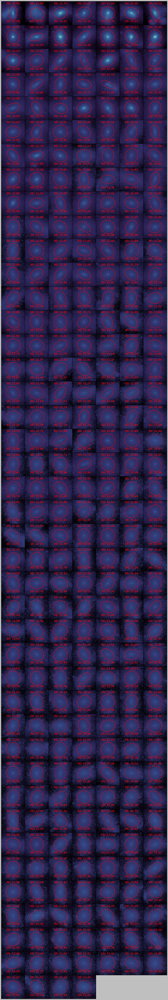

In [183]:
# Prepare the plot
fig = plt.figure(figsize=(14, 84))
fig.subplots_adjust(left=0.0, right=1.0, 
                    bottom=0.0, top=1.0,
                    wspace=0.00, hspace=0.00)

gs = gridspec.GridSpec(42, 7)
gs.update(wspace=0.0, hspace=0.00)

xArr, yArr, baArr, paArr, m10Arr, m30Arr, m100Arr, mtotArr = [], [], [], [], [], [], [], []
m150Arr, m200Arr = [], []
aperProf, aperMass = [], []
r50Arr = []

for ii in range(nSample):
    
    # Image
    msFile = os.path.join(msDir, 'map_' + str(ii).strip() + '.fits')
    img = fits.open(msFile)[0].data
    imgN = img.byteswap().newbyteorder()

    # Extract objects
    bkg = sep.Background(imgN, bw=10, bh=10, fw=3, fh=3)
    imgSub = imgN - bkg
    objects = sep.extract(imgSub, 20.0, filter_kernel=kernel3)

    # Find the object at the center
    if len(objects) == 1: 
        index = 0
    else: 
        index = np.argmin(np.sqrt((objects['x'] - cenX) ** 2.0 + (objects['y'] - cenY) ** 2.0))

    # Get the naive ba, theta, xcen, ycen
    ba = objects[index]['b'] / objects[index]['a']
    theta = objects[index]['theta']
    xcen, ycen = objects[index]['x'], objects[index]['y']
    baArr.append(ba)
    paArr.append(theta * 180.0 / np.pi)
    xArr.append(xcen)
    yArr.append(ycen)

    # Aperture photometry and naive "profiles"
    rad = np.linspace(1.0, 4.5, 60)
    kpc = (rad ** 4.0)
    pix = (kpc / scale)
    area = (np.pi * (kpc ** 2.0) * ba)
    maper = sep.sum_ellipse((imgN / h0), xcen, ycen, pix, pix * ba, theta, 1.0, 
                            bkgann=None, subpix=11)[0]
    mring = maper[1:] - maper[0:-1]
    aring = area[1:] - area[0:-1]
    rho = np.log10(mring / aring)
    aperMass.append(maper)
    aperProf.append(rho)
    
    # Mass within different apertures
    rad = np.asarray([10.0, 30.0, 100.0, 150.0, 200.0]) / scale
    maper = sep.sum_ellipse((imgN / h0), xcen, ycen, rad, rad * ba, theta, 1.0, 
                            bkgann=None, subpix=11)[0]
    
    m10Arr.append(np.log10(maper[0]))
    m30Arr.append(np.log10(maper[1]))
    m100Arr.append(np.log10(maper[2]))
    m150Arr.append(np.log10(maper[3]))
    m200Arr.append(np.log10(maper[4]))
    mtotArr.append(np.log10(np.sum(imgN)))
    
    # Get r50 
    r50, flag = sep.flux_radius((imgN / h0), xcen, ycen, 30.0, 0.5,
                                subpix=11)
    r50Arr.append(r50 * scale)

    # Show the aperture
    ax = plt.subplot(gs[ii])
    ax.yaxis.set_major_formatter(NullFormatter())
    ax.xaxis.set_major_formatter(NullFormatter())

    imgN = np.arcsinh(imgN)
    m, s = np.mean(imgN), np.std(imgN)
    im = ax.imshow(imgN, interpolation='nearest', cmap=CUBE,
                   vmin=m-1.5*s, vmax=m+8*s, origin='lower')

    # plot an ellipse for each object
    for i in range(len(objects)):
        e = Ellipse(xy=(xcen, ycen),
                    width=(100 / scale) * 2.0,
                    height=((100 / scale) * 2.0 * ba),
                    angle=(theta * 180. / np.pi))
        e.set_facecolor('none')
        e.set_edgecolor('r')
        e.set_alpha(0.5)
        e.set_linewidth(1.0)
        ax.add_artist(e)
    ax.set_aspect('equal')
    
    # Show the 2D and 3D mass within 100 kpc 
    ax.text(0.5, 0.90, "3D: %5.2f" % logmsCat[ii], 
            verticalalignment='center', horizontalalignment='center',
            fontsize=15.0, transform=ax.transAxes, weight='bold', 
            color='r', alpha=0.8)
    ax.text(0.5, 0.15, "2D: %5.2f" % np.log10(maper[4]), 
            verticalalignment='center', horizontalalignment='center',
            fontsize=15.0, transform=ax.transAxes, weight='bold', 
            color='r', alpha=0.8)

fig.savefig('mblack2_map_aperture_1.pdf', dpi=80)

In [240]:
cat = Table()

cat['mstar'] = Column(msCat, unit='solar mass', 
                      description='Stellar mass from the simulation')
cat['mhalo'] = Column(mhCat, unit='halo mass', 
                      description='Halo mass from the simulation')
cat['logmstar'] = Column(np.log10(msCat), unit='solar mass', 
                         description='Stellar mass from the simulation')
cat['logmhalo'] = Column(np.log10(mhCat), unit='halo mass', 
                         description='Halo mass from the simulation')

cat['x_pos'] = Column(posCat[:,0], unit='X position', 
                      description='X position in simulation')
cat['y_pos'] = Column(posCat[:,1], unit='Y position', 
                      description='Y position in simulation')
cat['z_pos'] = Column(posCat[:,2], unit='Z position', 
                      description='Z position in simulation')

cat['xCen_aper'] = Column(xArr, description='Aperture center X')
cat['yCen_aper'] = Column(yArr, description='Aperture center Y')
cat['ba_aper'] = Column(baArr, description='b/a from SEP photometry')
cat['pa_aper'] = Column(paArr, description='PA from SEP photometry')

cat['m10_aper'] = Column(m10Arr, unit='logMsun', 
                         description='Mass within 10 Kpc from aperture photometry')
cat['m30_aper'] = Column(m30Arr, unit='logMsun', 
                         description='Mass within 30 Kpc from aperture photometry')
cat['m100_aper'] = Column(m100Arr, unit='logMsun', 
                          description='Mass within 100 Kpc from aperture photometry')
cat['m150_aper'] = Column(m150Arr, unit='logMsun', 
                          description='Mass within 150 Kpc from aperture photometry')
cat['m200_aper'] = Column(m200Arr, unit='logMsun', 
                          description='Mass within 200 Kpc from aperture photometry')

cat['r50_aper'] = Column(r50Arr, unit='kpc', 
                         description='R_50 from aperture photometry')

cat['sbp_aper'] = Column(aperProf)
cat['mass_aper'] = Column(aperMass)

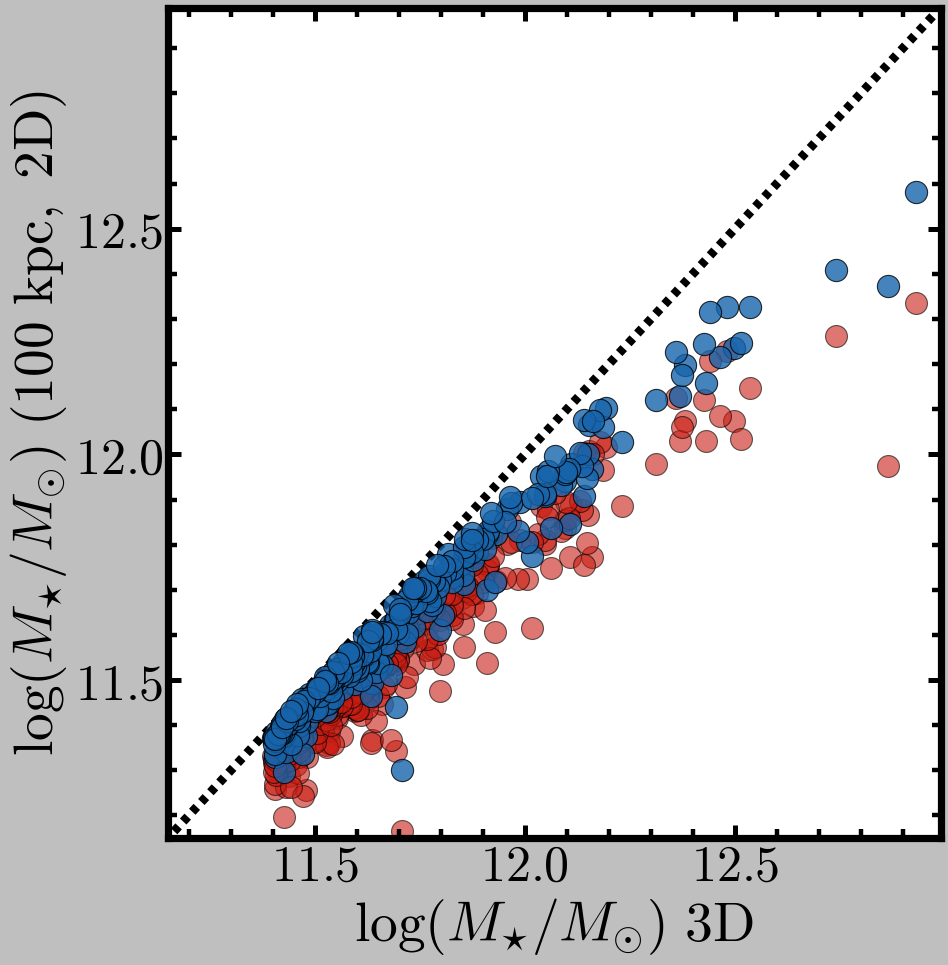

In [186]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

ax1.scatter(np.log10(cat['mstar']), cat['m100_aper'], 
            s=390, c=ORG(0.8), alpha=0.6)
ax1.scatter(np.log10(cat['mstar']), cat['m200_aper'], 
            s=400, c=BLU(0.8), alpha=0.8)

ax1.plot(np.asarray([11.1, 13.4]), np.asarray([11.1, 13.4]), linestyle='--', linewidth=8, c='k', zorder=0)

ax1.set_xlabel('$\log (M_{\star}/M_{\odot})\ \mathrm{3D}$', size=50)
ax1.set_ylabel('$\log (M_{\star}/M_{\odot})\ (100\ \mathrm{kpc},\ \mathrm{2D})$', size=50)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(11.15, 12.99)
ax1.set_ylim(11.15, 12.99)

fig.savefig('mblack2_mass_compare_m100_z0.30.pdf', dpi=80)

# Estimate the average shape and ellipticity profiles 

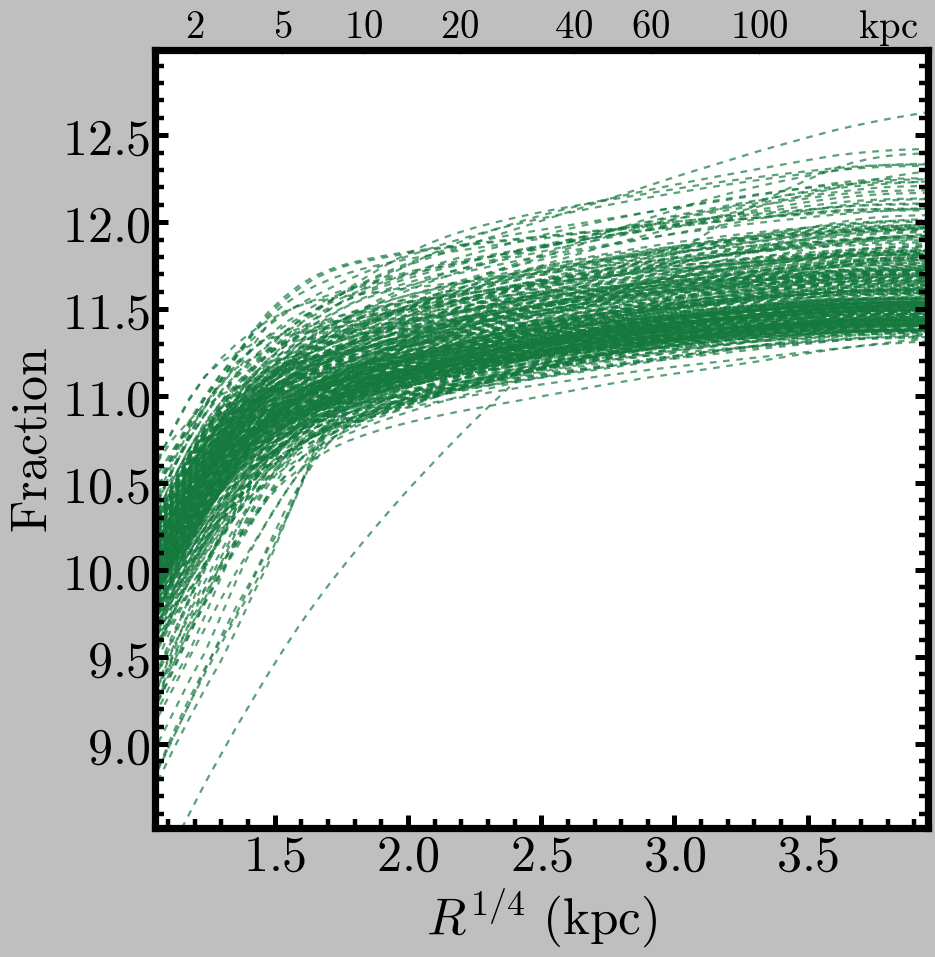

In [187]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

r50Arr = []
# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.940,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

rad = np.linspace(1.0, 4.5, 60)
kpc = (rad ** 4.0)

for gal in cat:
    mProf = gal['mass_aper']
    ax1.plot(kpc ** 0.25, np.log10(mProf), linestyle='--', linewidth=2, 
             c=GRN(0.8), alpha=0.7)
    
ax1.axhline(0.5, linestyle='-', linewidth=5.0, c=BLK(0.6), alpha=0.5, zorder=0)

## Label
ax1.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=46)
ax1.set_ylabel('$\mathrm{Fraction}$', size=45)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(1.05, 3.95)
ax1.set_ylim(8.52, 12.99)
# --------------------------------------------------------------------------------------- #
## Secondary Axis 
kpcArr = [2.0, 5.0, 10.0, 20.0, 40.0, 60.0, 100.0]
ax1b = ax1.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax1b.set_xlim(1.05, 3.75)
ax1b.set_xticks(kpcTicks)
ax1b.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=35)
for tick in ax1b.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1b.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax1b.text(0.91, 1.0035, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=35.0, transform=ax1b.transAxes)

fig.savefig('mblack2_cog_z0.3.pdf', dpi=80)

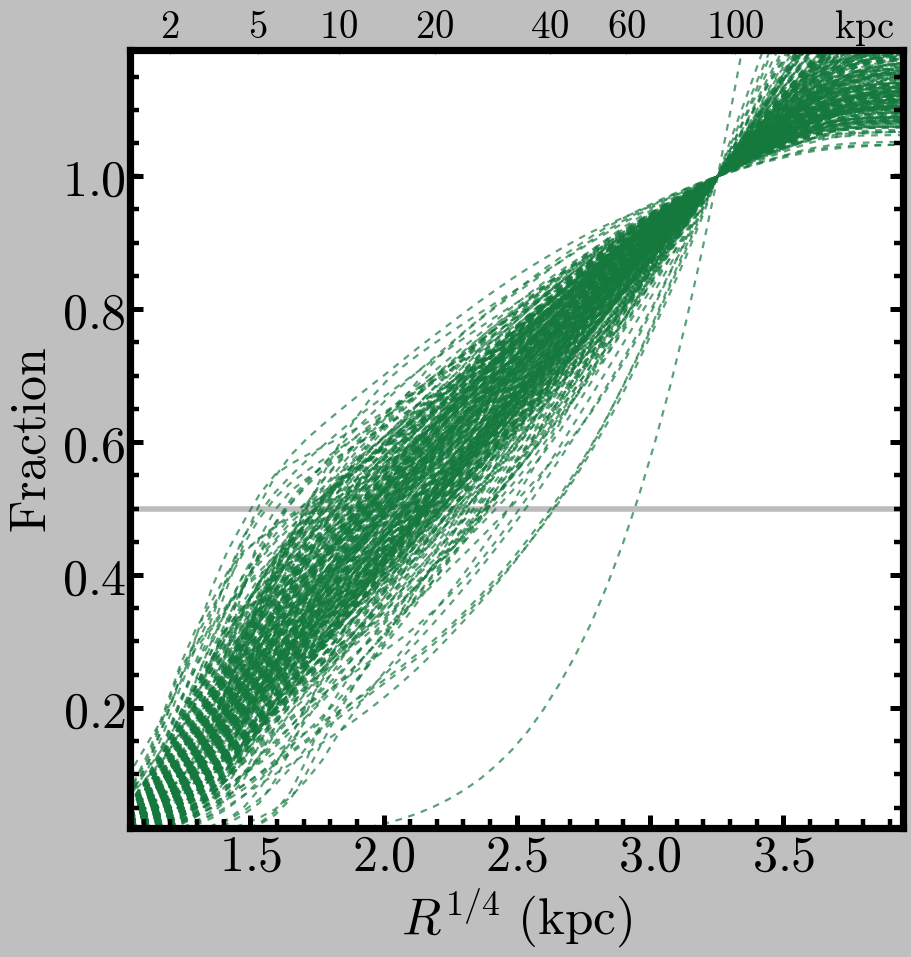

In [188]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

r50Arr = []
# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.940,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

rad = np.linspace(1.0, 4.5, 60)
kpc = (rad ** 4.0)

for gal in cat:
    mProf = gal['mass_aper']
    mMax = np.nanmax(mProf[(kpc <= 120.0)])
    fracMax = (mProf / mMax)
    fracInterp = interp1d(fracMax, kpc)
    r50 = fracInterp(0.50)
    r50Arr.append(r50)
    ax1.plot(kpc ** 0.25, mProf / mMax, linestyle='--', linewidth=2, c=GRN(0.8), alpha=0.7)
    
ax1.axhline(0.5, linestyle='-', linewidth=5.0, c=BLK(0.6), alpha=0.5, zorder=0)

## Label
ax1.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=46)
ax1.set_ylabel('$\mathrm{Fraction}$', size=45)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(1.05, 3.95)
ax1.set_ylim(0.02, 1.19)
# --------------------------------------------------------------------------------------- #
## Secondary Axis 
kpcArr = [2.0, 5.0, 10.0, 20.0, 40.0, 60.0, 100.0]
ax1b = ax1.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax1b.set_xlim(1.05, 3.75)
ax1b.set_xticks(kpcTicks)
ax1b.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=35)
for tick in ax1b.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1b.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax1b.text(0.91, 1.0035, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=35.0, transform=ax1b.transAxes)

fig.savefig('mblack2_cog_fraction_z0.3.pdf', dpi=80)

In [241]:
cat['r50_prof'] = Column(np.asarray(r50Arr), unit='kpc', 
                         description='R50 from Aperture profiles')

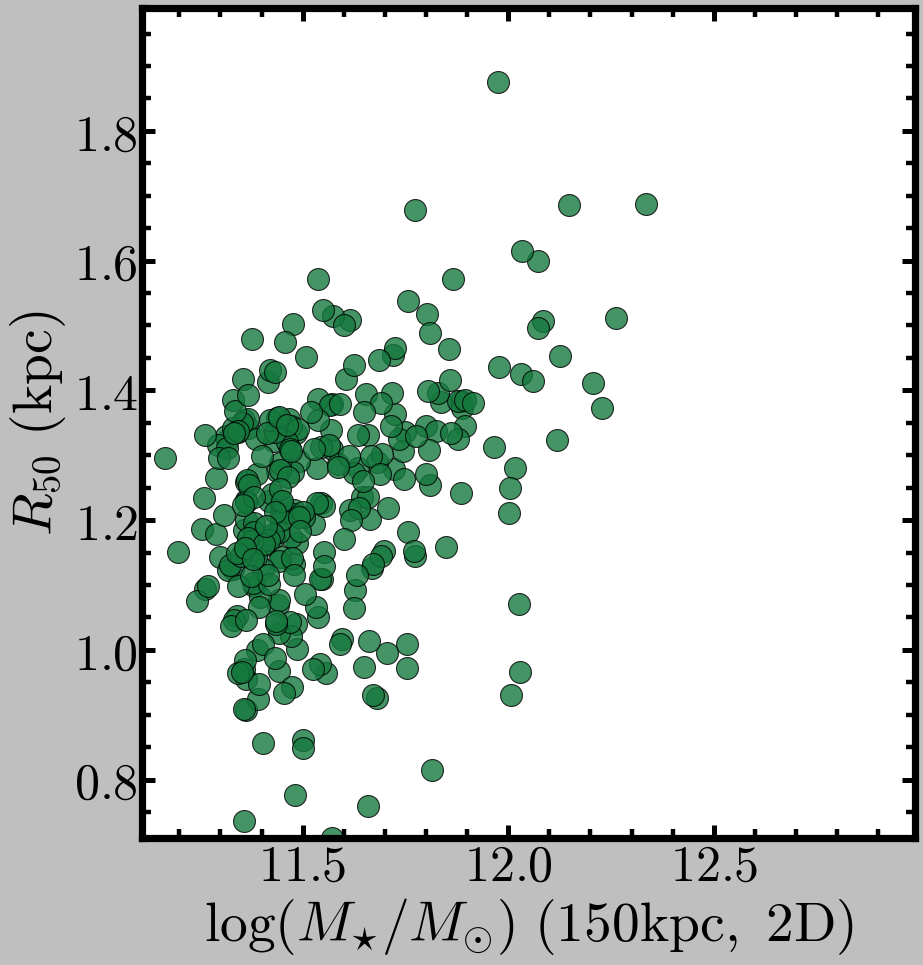

In [191]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

ax1.scatter(cat['m100_aper'], np.log10(cat['r50_prof']), 
            s=390, c=GRN(0.8), alpha=0.8)

#ax1.plot(np.asarray([11.4, 12.2]), np.asarray([11.4, 12.2]), linestyle='--', linewidth=8, c='k', zorder=0)

ax1.set_xlabel('$\log (M_{\star}/M_{\odot})\ (150 \mathrm{kpc},\ \mathrm{2D})$', size=50)
ax1.set_ylabel('$R_{50}\ (\mathrm{kpc})$', size=50)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(11.11, 12.99)
ax1.set_ylim(0.71, 1.99)

fig.savefig('mblack2_m100_r50_z0.30.pdf', dpi=80)

In [9]:
catC = copy.deepcopy(cat)
catC = catC[(catC['m10_aper'] > 10.2) & (catC['logmhalo'] >= 13.2)]

xx, yy = catC['logmhalo'], catC['logmstar']
xx = xx[catC['logmhalo'] >= 13.4]
yy = yy[catC['logmhalo'] >= 13.4]
yyErr = yy * 0.0 + 0.02

A = np.vstack((np.ones_like(xx), xx)).T
C = np.diag(yyErr * yyErr)
cov = np.linalg.inv(np.dot(A.T, np.linalg.solve(C, A)))
bb1, aa1 = np.dot(cov, np.dot(A.T, np.linalg.solve(C, yy)))

####### 

xx, yy = catC['logmhalo'], catC['m100_aper']
xx = xx[catC['logmhalo'] >= 13.4]
yy = yy[catC['logmhalo'] >= 13.4]
yyErr = yy * 0.0 + 0.01

A = np.vstack((np.ones_like(xx), xx)).T
C = np.diag(yyErr * yyErr)
cov = np.linalg.inv(np.dot(A.T, np.linalg.solve(C, A)))
bb2, aa2 = np.dot(cov, np.dot(A.T, np.linalg.solve(C, yy)))

####### 

xx, yy = catC['logmhalo'], catC['m10_aper']
xx = xx[catC['logmhalo'] >= 13.4]
yy = yy[catC['logmhalo'] >= 13.4]
yyErr = yy * 0.0 + 0.05

A = np.vstack((np.ones_like(xx), xx)).T
C = np.diag(yyErr * yyErr)
cov = np.linalg.inv(np.dot(A.T, np.linalg.solve(C, A)))
bb3, aa3 = np.dot(cov, np.dot(A.T, np.linalg.solve(C, yy)))

print(aa1, aa2, aa3)

0.878153 0.620631717272 0.407089183356


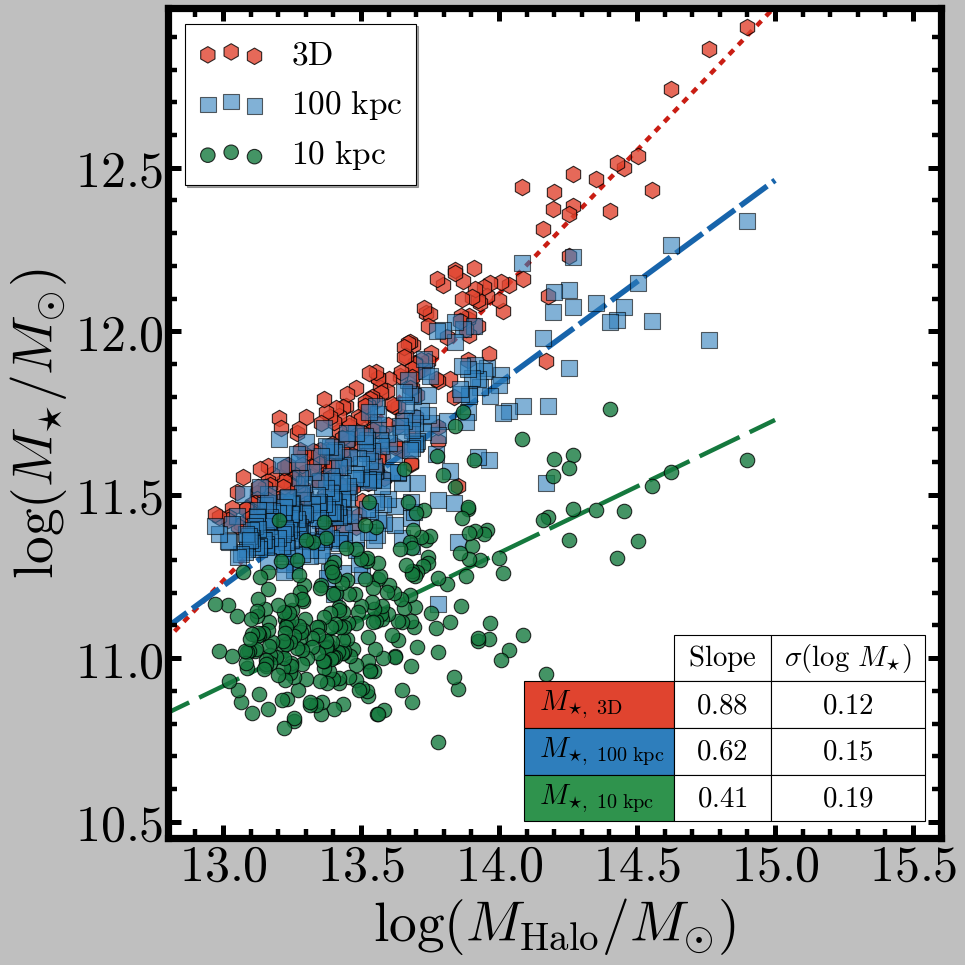

In [12]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

ax1.scatter(np.log10(cat['mhalo']), np.log10(cat['mstar']), marker='h', 
            s=220, c=ORG(0.7), alpha=0.8, label=r'$\mathrm{3D}$')

xx = np.linspace(12.0, 15.0, 200)
yy = aa1 * xx + bb1
ax1.plot(xx, yy, linestyle='--', linewidth=4, c=ORG(0.8), zorder=0)

ax1.scatter(np.log10(cat['mhalo']), cat['m100_aper'], marker='s',
            s=200, c=BLU(0.7), alpha=0.6, label=r'$100\ \mathrm{kpc}$')

xx = np.linspace(12.0, 15.0, 200)
yy = aa2 * xx + bb2
ax1.plot(xx, yy, linestyle='--', linewidth=5, c=BLU(0.8), zorder=0, dashes=(30, 6))

ax1.scatter(np.log10(cat['mhalo']), cat['m10_aper'], 
            s=170, c=GRN(0.8), alpha=0.8, label=r'$10\ \mathrm{kpc}$')

#ax1.plot(np.asarray([11.4, 12.2]), np.asarray([11.4, 12.2]), linestyle='--', linewidth=8, c='k', zorder=0)

ax1.set_xlabel('$\log (M_{\mathrm{Halo}}/M_{\odot})$', size=50)
ax1.set_ylabel('$\log (M_{\star}/M_{\odot})$', size=50)

xx = np.linspace(12.0, 15.0, 200)
yy = aa3 * xx + bb3
ax1.plot(xx, yy, linestyle='--', linewidth=4, c=GRN(0.8), zorder=0, dashes=(40, 10))

legend = ax1.legend(loc='upper left', shadow=True, fontsize=30)


# --------------------------------------------------------------------------------------- #
col_labels = [r'$\mathrm{Slope}$', r'$\sigma(\log\ M_{\star})$']
row_labels = [r'$M_{\star,\ \mathrm{3D}}$', r'$M_{\star,\ \mathrm{100\ kpc}}$', 
              r'$M_{\star,\ \mathrm{10 \ kpc}}$']
table_vals = [['$0.88$', '$0.12$'], ['$0.62$', '$0.15$'], ['$0.41$', '$0.19$']]

the_table = ax1.table(cellText=table_vals,
                      colWidths=[0.05, 0.08],
                      rowLabels=row_labels,
                      colLabels=col_labels,
                      cellLoc='center',
                      rowColours=[ORG(0.7), BLU(0.7), GRN(0.7)],
                      loc='lower right', zorder=100)
the_table.auto_set_font_size(False)
the_table.set_fontsize(26)
the_table.scale(2.5, 3.5)
# --------------------------------------------------------------------------------------- #


# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(12.8, 15.6)
ax1.set_ylim(10.45, 12.99)

fig.savefig('mblack2_mhalo_mstar_z0.30_1.pdf', dpi=80)

In [149]:
label1 = (cat['logmhalo'] > 13.5) & (cat['logmhalo'] < 13.8)
label2 = (cat['logmhalo'] > 13.8) & (cat['logmhalo'] < 14.2)
label3 = (cat['logmhalo'] > 13.4) & (cat['logmhalo'] < 14.2)

print(np.nanstd(cat[label1]['logmstar']), np.nanstd(cat[label1]['m100_aper']), np.nanstd(cat[label1]['m10_aper']))
print(np.nanstd(cat[label2]['logmstar']), np.nanstd(cat[label2]['m100_aper']), np.nanstd(cat[label2]['m10_aper']))
print(np.nanstd(cat[label3]['logmstar']), np.nanstd(cat[label3]['m100_aper']), np.nanstd(cat[label3]['m10_aper']))

0.144307 0.161502929461 0.188590115726
0.167319 0.173901178336 0.226984172031
0.216011 0.195860011441 0.201413658156


0.119463 0.150221353218 0.181662242927
0.141063 0.168190805672 0.228278783156
0.123676 0.148427936713 0.183335284331


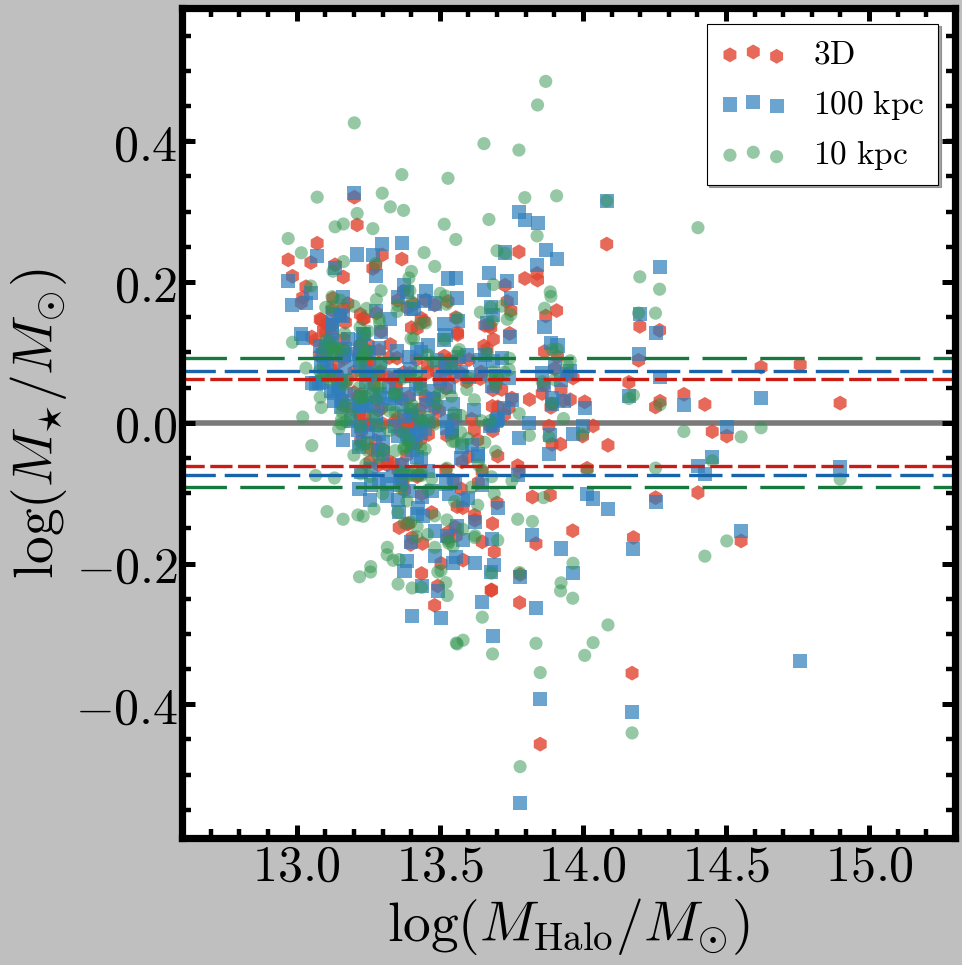

In [154]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

yy1 = cat['logmstar'] - (aa1 * cat['logmhalo'] + bb1)
ax1.scatter(cat['logmhalo'], yy1 , marker='h', edgecolor='none',
            s=180, c=ORG(0.7), alpha=0.8, label=r'$\mathrm{3D}$')

yy2 = cat['m100_aper'] - (aa2 * cat['logmhalo'] + bb2)
ax1.scatter(cat['logmhalo'], yy2 , marker='s', edgecolor='none',
            s=160, c=BLU(0.7), alpha=0.7, label=r'$100\ \mathrm{kpc}$')

yy3 = cat['m10_aper'] - (aa3 * cat['logmhalo'] + bb3)
ax1.scatter(cat['logmhalo'], yy3 , marker='o', edgecolor='none',
            s=140, c=GRN(0.7), alpha=0.5, label=r'$10\ \mathrm{kpc}$')

print(np.nanstd(yy1[label1]), np.nanstd(yy2[label1]), np.nanstd(yy3[label1]))
print(np.nanstd(yy1[label2]), np.nanstd(yy2[label2]), np.nanstd(yy3[label2]))
print(np.nanstd(yy1[label3]), np.nanstd(yy2[label3]), np.nanstd(yy3[label3]))
ax1.axhline(np.nanstd(yy1[label3])/2, c=ORG(0.8), linestyle='--', linewidth=3, dashes=(20,5))
ax1.axhline(np.nanstd(yy1[label3])/-2, c=ORG(0.8), linestyle='--', linewidth=3, dashes=(20,5))

ax1.axhline(np.nanstd(yy2[label3])/2, c=BLU(0.8), linestyle='--', linewidth=3, dashes=(30,8))
ax1.axhline(np.nanstd(yy2[label3])/-2, c=BLU(0.8), linestyle='--', linewidth=3, dashes=(30,8))

ax1.axhline(np.nanstd(yy3[label3])/2, c=GRN(0.8), linestyle='--', linewidth=3, dashes=(40,12))
ax1.axhline(np.nanstd(yy3[label3])/-2, c=GRN(0.8), linestyle='--', linewidth=3, dashes=(40,12))

ax1.set_xlabel('$\log (M_{\mathrm{Halo}}/M_{\odot})$', size=50)
ax1.set_ylabel('$\log (M_{\star}/M_{\odot})$', size=50)


ax1.axhline(0.0, linestyle='-', c=BLK(0.6), linewidth=5.0, zorder=0)

legend = ax1.legend(loc='upper right', shadow=True, fontsize=30)

# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(12.6, 15.3)
ax1.set_ylim(-0.59, 0.59)

fig.savefig('mblack2_mhalo_mstar_norm_z0.30_1.pdf', dpi=80)

In [196]:
xx, yy = cat['logmstar'], cat['logmhalo']
xx = xx[cat['logmstar'] >= 11.45]
yy = yy[cat['logmstar'] >= 11.45]
yyErr = yy * 0.0 + 0.04

A = np.vstack((np.ones_like(xx), xx)).T
C = np.diag(yyErr * yyErr)
cov = np.linalg.inv(np.dot(A.T, np.linalg.solve(C, A)))
bb1, aa1 = np.dot(cov, np.dot(A.T, np.linalg.solve(C, yy)))

####

xx, yy = cat['m100_aper'], cat['logmhalo']
xx = xx[cat['m100_aper'] >= 11.45]
yy = yy[cat['m100_aper'] >= 11.45]
yyErr = yy * 0.0 + 0.04

A = np.vstack((np.ones_like(xx), xx)).T
C = np.diag(yyErr * yyErr)
cov = np.linalg.inv(np.dot(A.T, np.linalg.solve(C, A)))
bb2, aa2 = np.dot(cov, np.dot(A.T, np.linalg.solve(C, yy)))

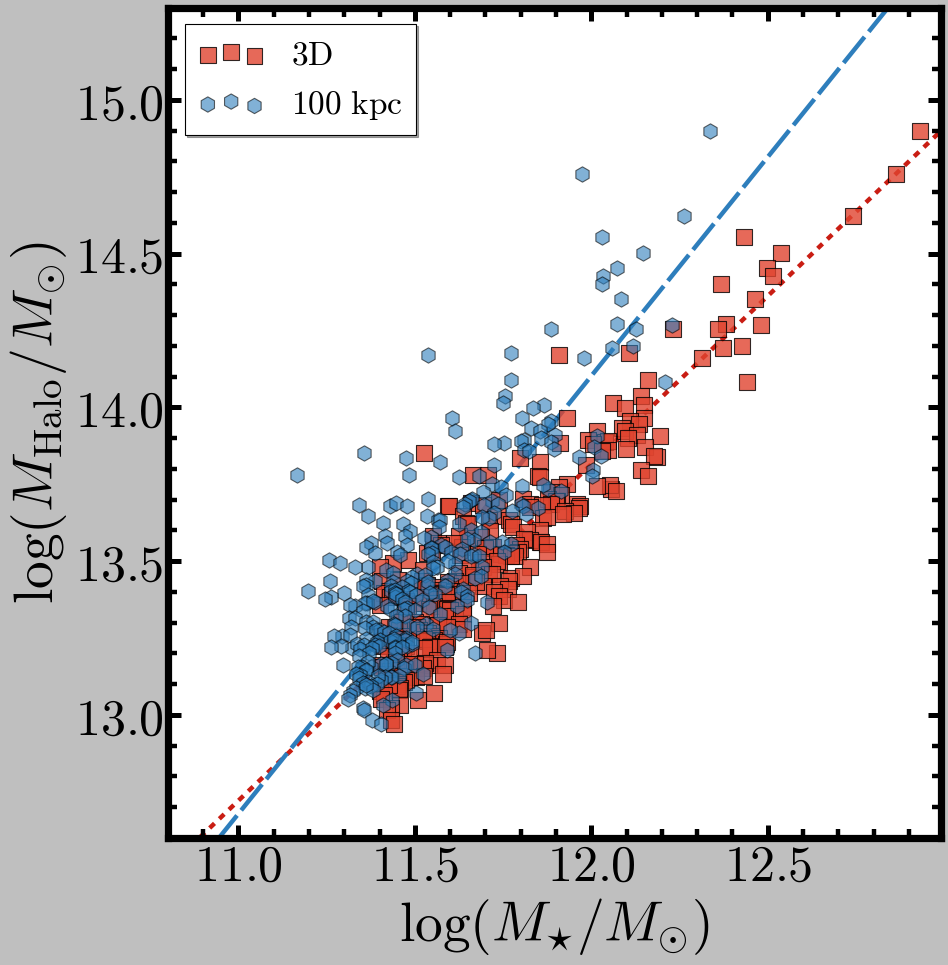

In [197]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

ax1.scatter(cat['logmstar'], cat['logmhalo'], marker='s', 
            s=200, c=ORG(0.7), alpha=0.8, label=r'$\mathrm{3D}$')

xx = np.linspace(10.5, 13.0, 200)
yy = aa1 * xx + bb1
ax1.plot(xx, yy, linestyle='--', linewidth=4, c=ORG(0.8), zorder=0)


ax1.scatter(cat['m100_aper'], cat['logmhalo'], marker='h',
            s=190, c=BLU(0.7), alpha=0.6, label=r'$100\ \mathrm{kpc}$')

xx = np.linspace(10.5, 13.0, 200)
yy = aa2 * xx + bb2
ax1.plot(xx, yy, linestyle='--', linewidth=4, c=BLU(0.7), dashes=(30, 6), zorder=0)


ax1.set_xlabel('$\log (M_{\star}/M_{\odot})$', size=50)
ax1.set_ylabel('$\log (M_{\mathrm{Halo}}/M_{\odot})$', size=50)

legend = ax1.legend(loc='upper left', shadow=True, fontsize=30)

# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(10.8, 12.99)
ax1.set_ylim(12.6, 15.3)

fig.savefig('mblack2_mstar_mhalo_z0.30_1.pdf', dpi=80)

In [330]:
print(np.nanmedian(cat[(cat['logmstar'] > 11.6) & (cat['logmstar'] < 12.0)]['logmhalo']))
label4 = (cat['logmhalo'] >= 13.54) & (cat['logmstar'] > 11.6) & (cat['logmhalo'] < 14.5) & (cat['logmstar'] < 12.0)
label5 = (cat['logmhalo'] < 13.54) & (cat['logmstar'] > 11.6) & (cat['logmhalo'] < 14.5) & (cat['logmstar'] < 12.0)
hiMh1 = cat[label4]
loMh1 = cat[label5]
print(np.nanmedian(hiMh1['logmhalo']), np.nanmedian(loMh1['logmhalo']))

print(np.nanmedian(cat[(cat['m100_aper'] > 11.6) & (cat['m100_aper'] < 12.0)]['logmhalo']))
label6 = (cat['logmhalo'] >= 13.69) & (cat['m100_aper'] > 11.6) & (cat['logmhalo'] < 14.5) & (cat['m100_aper'] < 12.0)
label7 = (cat['logmhalo'] < 13.69) & (cat['m100_aper'] > 11.6) & (cat['logmhalo'] < 14.5) & (cat['m100_aper'] < 12.0)
hiMh2 = cat[label6]
loMh2 = cat[label7]
print(np.nanmedian(hiMh2['logmhalo']), np.nanmedian(loMh2['logmhalo']))

13.5497
13.661 13.4333
13.6911
13.8859 13.5359


In [198]:
above1 = (cat['logmhalo'] - (aa1 * cat['logmstar'] + bb1) >= 0) & (cat['logmstar'] > 11.45)
under1 = (cat['logmhalo'] - (aa1 * cat['logmstar'] + bb1) < 0) & (cat['logmstar'] > 11.45)
print(np.nanmedian(cat[above1]['logmhalo']), np.nanmedian(cat[under1]['logmhalo']))

above2 = (cat['logmhalo'] - (aa2 * cat['m100_aper'] + bb2) >= 0) & (cat['m100_aper'] > 11.45)
under2 = (cat['logmhalo'] - (aa2 * cat['m100_aper'] + bb2) < 0) & (cat['m100_aper'] > 11.45)
print(np.nanmedian(cat[above2]['logmhalo']), np.nanmedian(cat[under2]['logmhalo']))

13.5815 13.3738
13.7471 13.4816


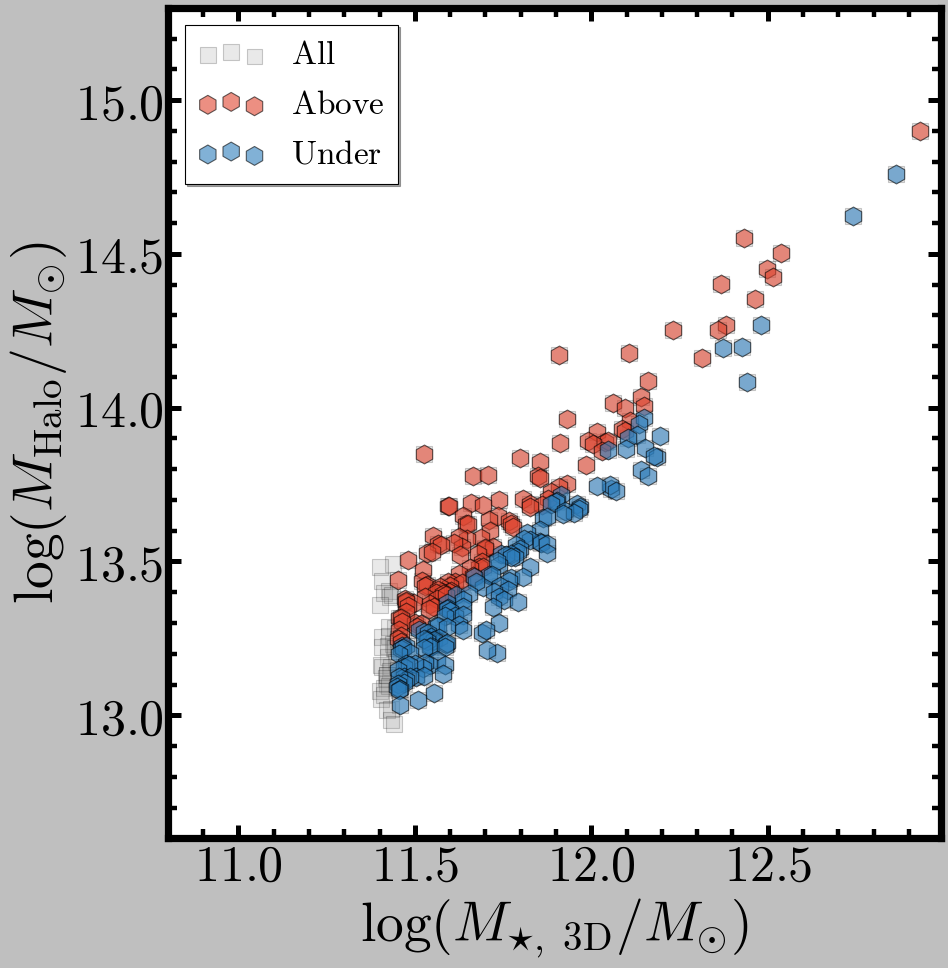

In [339]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

ax1.scatter(cat['logmstar'], cat['logmhalo'], marker='s', 
            s=200, c=BLK(0.5), alpha=0.2, label=r'$\mathrm{All}$')


ax1.scatter(cat[above1]['logmstar'], cat[above1]['logmhalo'], marker='h',
            s=290, c=ORG(0.7), alpha=0.6, label=r'$\mathrm{Above}$')

ax1.scatter(cat[under1]['logmstar'], cat[under1]['logmhalo'], marker='h',
            s=290, c=BLU(0.7), alpha=0.6, label=r'$\mathrm{Under}$')

xx = np.linspace(10.5, 13.0, 200)
yy = aa1 * xx + bb1
ax1.plot(xx, yy, linestyle='--', linewidth=4, c=BLU(0.7), dashes=(30, 6), zorder=0)

ax1.set_xlabel('$\log (M_{\star,\ \mathrm{3D}}/M_{\odot})$', size=50)
ax1.set_ylabel('$\log (M_{\mathrm{Halo}}/M_{\odot})$', size=50)

legend = ax1.legend(loc='upper left', shadow=True, fontsize=30)

# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(10.8, 12.99)
ax1.set_ylim(12.6, 15.3)

fig.savefig('mblack2_mstar_mhalo_z0.30_2.pdf', dpi=80)

In [ ]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

ax1.scatter(cat['logmstar'], cat['logmhalo'], marker='s', 
            s=200, c=BLK(0.5), alpha=0.2, label=r'$\mathrm{All}$')


ax1.scatter(cat[above1]['logmstar'], cat[above1]['logmhalo'], marker='h',
            s=290, c=ORG(0.7), alpha=0.6, label=r'$\mathrm{Above}$')

ax1.scatter(cat[under1]['logmstar'], cat[under1]['logmhalo'], marker='h',
            s=290, c=BLU(0.7), alpha=0.6, label=r'$\mathrm{Under}$')

xx = np.linspace(10.5, 13.0, 200)
yy = aa1 * xx + bb1
ax1.plot(xx, yy, linestyle='--', linewidth=4, c=BLU(0.7), dashes=(30, 6), zorder=0)

ax1.set_xlabel('$\log (M_{\star,\ \mathrm{3D}}/M_{\odot})$', size=50)
ax1.set_ylabel('$\log (M_{\mathrm{Halo}}/M_{\odot})$', size=50)

legend = ax1.legend(loc='upper left', shadow=True, fontsize=30)

# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(10.8, 12.99)
ax1.set_ylim(12.6, 15.3)

fig.savefig('mblack2_mstar_mhalo_z0.30_2.pdf', dpi=80)

In [ ]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

ax1.scatter(cat['logmstar'], cat['logmhalo'], marker='s', 
            s=200, c=BLK(0.5), alpha=0.2, label=r'$\mathrm{All}$')


ax1.scatter(cat[above1]['logmstar'], cat[above1]['logmhalo'], marker='h',
            s=290, c=ORG(0.7), alpha=0.6, label=r'$\mathrm{Above}$')

ax1.scatter(cat[under1]['logmstar'], cat[under1]['logmhalo'], marker='h',
            s=290, c=BLU(0.7), alpha=0.6, label=r'$\mathrm{Under}$')

xx = np.linspace(10.5, 13.0, 200)
yy = aa1 * xx + bb1
ax1.plot(xx, yy, linestyle='--', linewidth=4, c=BLU(0.7), dashes=(30, 6), zorder=0)

ax1.set_xlabel('$\log (M_{\star,\ \mathrm{3D}}/M_{\odot})$', size=50)
ax1.set_ylabel('$\log (M_{\mathrm{Halo}}/M_{\odot})$', size=50)

legend = ax1.legend(loc='upper left', shadow=True, fontsize=30)

# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(10.8, 12.99)
ax1.set_ylim(12.6, 15.3)

fig.savefig('mblack2_mstar_mhalo_z0.30_2.pdf', dpi=80)

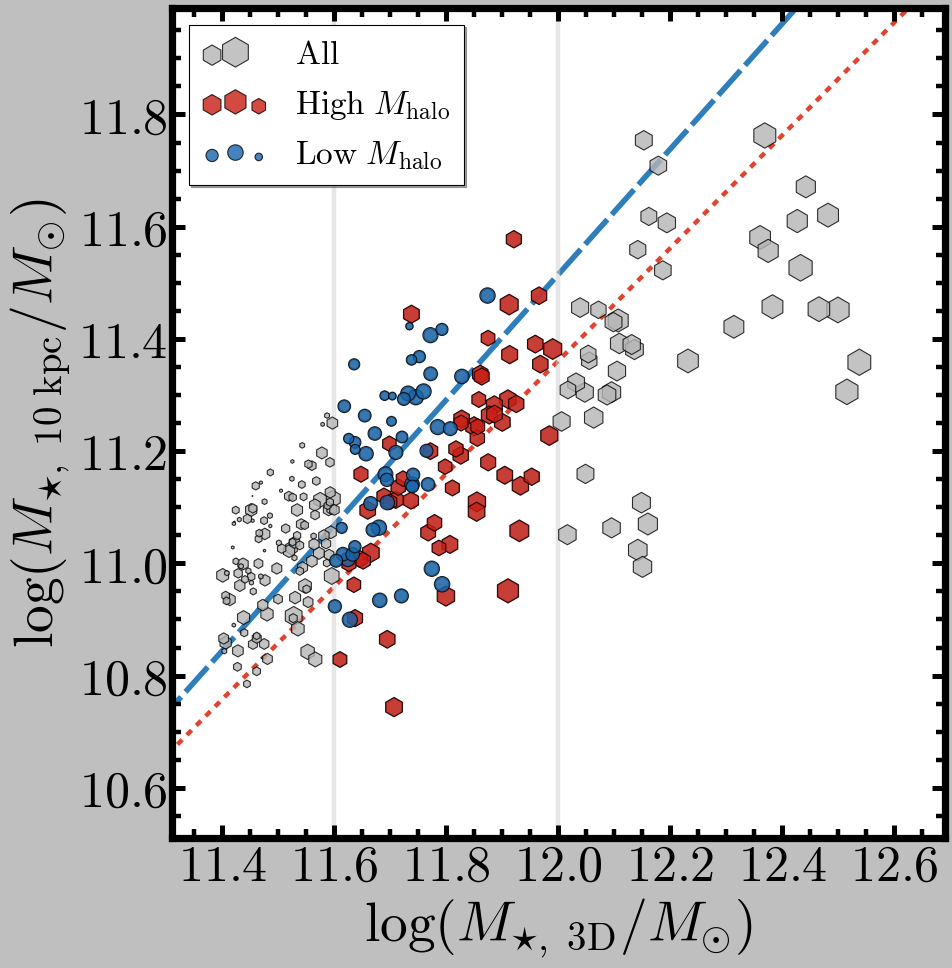

In [328]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)


ax1.scatter(cat['logmstar'], cat['m10_aper'], marker='h', 
            s=(cat['logmhalo'] - 13.1) * 400, c=BLK(0.4), alpha=0.6, 
            label=r'$\mathrm{All}$')

xx, yy = hiMh1['logmstar'], hiMh1['m10_aper']
xx = xx[hiMh1['logmstar'] < 12.2]
yy = yy[hiMh1['logmstar'] < 12.2]
yyErr = yy * 0.0 + 0.03

A = np.vstack((np.ones_like(xx), xx)).T
C = np.diag(yyErr * yyErr)
cov = np.linalg.inv(np.dot(A.T, np.linalg.solve(C, A)))
bb1, aa1 = np.dot(cov, np.dot(A.T, np.linalg.solve(C, yy)))

ax1.scatter(hiMh1['logmstar'], hiMh1['m10_aper'], marker='h', 
            s=(hiMh1['logmhalo'] - 13.1) * 450, c=ORG(0.8), alpha=0.8, 
            label=r'$\mathrm{High\ }M_{\mathrm{halo}}$')

xx = np.linspace(11.0, 12.9, 200)
ax1.plot(xx, (xx * aa1 + bb1), c=ORG(0.7), linestyle='--', linewidth=4, zorder=0)

########

xx, yy = loMh1['logmstar'], loMh1['m10_aper']
xx = xx[loMh1['logmstar'] < 12.2]
yy = yy[loMh1['logmstar'] < 12.2]
yyErr = yy * 0.0 + 0.03

A = np.vstack((np.ones_like(xx), xx)).T
C = np.diag(yyErr * yyErr)
cov = np.linalg.inv(np.dot(A.T, np.linalg.solve(C, A)))
bb2, aa2 = np.dot(cov, np.dot(A.T, np.linalg.solve(C, yy)))

ax1.scatter(loMh1['logmstar'], loMh1['m10_aper'], 
            s=(loMh1['logmhalo'] - 13.1) * 450, c=BLU(0.8), alpha=0.8, 
            label=r'$\mathrm{Low\ }M_{\mathrm{halo}}$')

xx = np.linspace(11.0, 12.9, 200)
ax1.plot(xx, (xx * aa2 + bb2), c=BLU(0.7), linestyle='--', linewidth=5.0, dashes=(30, 6), zorder=0)

ax1.axvline(11.6, linestyle='-', c=BLK(0.3), linewidth=4.0, zorder=0, alpha=0.5)
ax1.axvline(12.0, linestyle='-', c=BLK(0.3), linewidth=4.0, zorder=0, alpha=0.5)

ax1.set_xlabel('$\log (M_{\star,\ \mathrm{3D}}/M_{\odot})$', size=50)
ax1.set_ylabel('$\log (M_{\star,\ 10\ \mathrm{kpc}}/M_{\odot})$', size=50)

legend = ax1.legend(loc='upper left', shadow=True, fontsize=30)

# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(11.31, 12.69)
ax1.set_ylim(10.51, 11.99)

fig.savefig('mblack2_mstar_m10_z0.30_2.pdf', dpi=80)

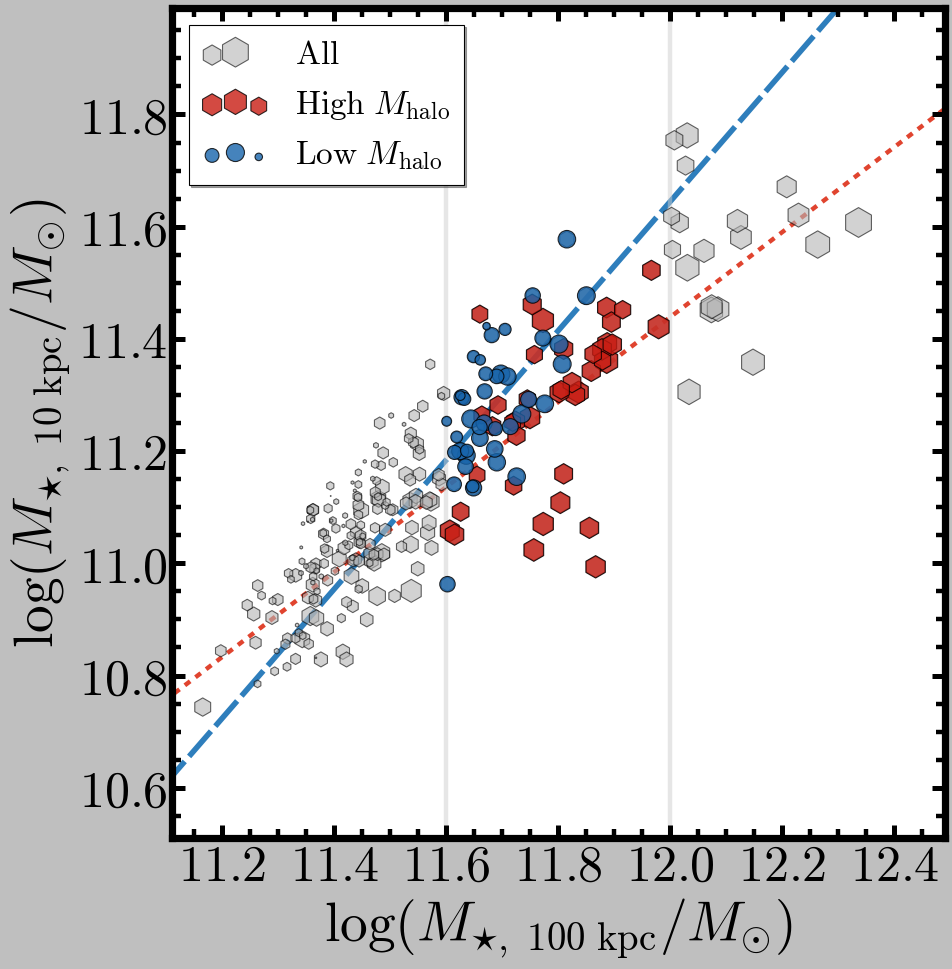

In [333]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)


ax1.scatter(cat['m100_aper'], cat['m10_aper'], marker='h', 
            s=(cat['logmhalo'] - 13.1) * 400, c=BLK(0.4), alpha=0.6, 
            label=r'$\mathrm{All}$')

xx, yy = hiMh2['m100_aper'], hiMh2['m10_aper']
xx = xx[hiMh2['m100_aper'] < 12.2]
yy = yy[hiMh2['m100_aper'] < 12.2]
yyErr = yy * 0.0 + 0.03

A = np.vstack((np.ones_like(xx), xx)).T
C = np.diag(yyErr * yyErr)
cov = np.linalg.inv(np.dot(A.T, np.linalg.solve(C, A)))
bb1, aa1 = np.dot(cov, np.dot(A.T, np.linalg.solve(C, yy)))

ax1.scatter(hiMh2['m100_aper'], hiMh2['m10_aper'], marker='h', 
            s=(hiMh2['logmhalo'] - 13.1) * 450, c=ORG(0.8), alpha=0.8, 
            label=r'$\mathrm{High\ }M_{\mathrm{halo}}$')

xx = np.linspace(11.0, 12.9, 200)
ax1.plot(xx, (xx * aa1 + bb1), c=ORG(0.7), linestyle='--', linewidth=4, zorder=0)

########

xx, yy = loMh2['m100_aper'], loMh2['m10_aper']
xx = xx[loMh2['m100_aper'] < 12.2]
yy = yy[loMh2['m100_aper'] < 12.2]
yyErr = yy * 0.0 + 0.03

A = np.vstack((np.ones_like(xx), xx)).T
C = np.diag(yyErr * yyErr)
cov = np.linalg.inv(np.dot(A.T, np.linalg.solve(C, A)))
bb2, aa2 = np.dot(cov, np.dot(A.T, np.linalg.solve(C, yy)))

ax1.scatter(loMh2['m100_aper'], loMh2['m10_aper'], 
            s=(loMh2['logmhalo'] - 13.1) * 450, c=BLU(0.8), alpha=0.8, 
            label=r'$\mathrm{Low\ }M_{\mathrm{halo}}$')

xx = np.linspace(11.0, 12.9, 200)
ax1.plot(xx, (xx * aa2 + bb2), c=BLU(0.7), linestyle='--', linewidth=5.0, dashes=(30, 6), zorder=0)

ax1.axvline(11.6, linestyle='-', c=BLK(0.3), linewidth=4.0, zorder=0, alpha=0.5)
ax1.axvline(12.0, linestyle='-', c=BLK(0.3), linewidth=4.0, zorder=0, alpha=0.5)

ax1.set_xlabel('$\log (M_{\star,\ 100\ \mathrm{kpc}}/M_{\odot})$', size=50)
ax1.set_ylabel('$\log (M_{\star,\ 10\ \mathrm{kpc}}/M_{\odot})$', size=50)

legend = ax1.legend(loc='upper left', shadow=True, fontsize=30)

# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(11.11, 12.49)
ax1.set_ylim(10.51, 11.99)

fig.savefig('mblack2_m100_m10_z0.30_2.pdf', dpi=80)

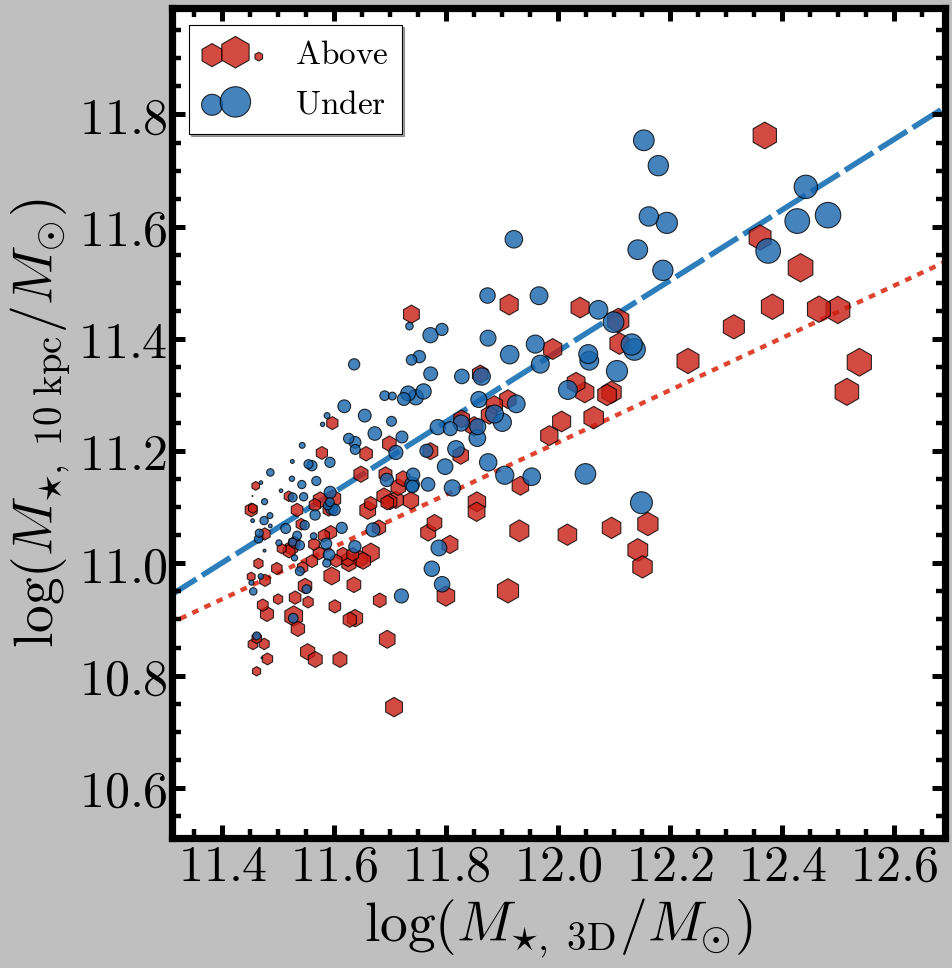

In [334]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

xx, yy = cat[above1]['logmstar'], cat[above1]['m10_aper']
xx = xx[cat[above1]['logmstar'] < 12.2]
yy = yy[cat[above1]['logmstar'] < 12.2]
yyErr = yy * 0.0 + 0.03

A = np.vstack((np.ones_like(xx), xx)).T
C = np.diag(yyErr * yyErr)
cov = np.linalg.inv(np.dot(A.T, np.linalg.solve(C, A)))
bb1, aa1 = np.dot(cov, np.dot(A.T, np.linalg.solve(C, yy)))

ax1.scatter(cat[above1]['logmstar'], cat[above1]['m10_aper'], marker='h', 
            s=(cat[above1]['logmhalo'] - 13.1) * 450, c=ORG(0.8), alpha=0.8, 
            label=r'$\mathrm{Above}$')

xx = np.linspace(11.0, 12.9, 200)
ax1.plot(xx, (xx * aa1 + bb1), c=ORG(0.7), linestyle='--', linewidth=4, zorder=0)

########

xx, yy = cat[under1]['logmstar'], cat[under1]['m10_aper']
xx = xx[cat[under1]['logmstar'] < 12.2]
yy = yy[cat[under1]['logmstar'] < 12.2]
yyErr = yy * 0.0 + 0.03

A = np.vstack((np.ones_like(xx), xx)).T
C = np.diag(yyErr * yyErr)
cov = np.linalg.inv(np.dot(A.T, np.linalg.solve(C, A)))
bb2, aa2 = np.dot(cov, np.dot(A.T, np.linalg.solve(C, yy)))

ax1.scatter(cat[under1]['logmstar'], cat[under1]['m10_aper'], 
            s=(cat[under1]['logmhalo'] - 13.1) * 450, c=BLU(0.8), alpha=0.8, 
            label=r'$\mathrm{Under}$')

xx = np.linspace(11.0, 12.9, 200)
ax1.plot(xx, (xx * aa2 + bb2), c=BLU(0.7), linestyle='--', linewidth=5.0, dashes=(30, 6), zorder=0)

ax1.set_xlabel('$\log (M_{\star,\ \mathrm{3D}}/M_{\odot})$', size=50)
ax1.set_ylabel('$\log (M_{\star,\ 10\ \mathrm{kpc}}/M_{\odot})$', size=50)

legend = ax1.legend(loc='upper left', shadow=True, fontsize=30)

# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(11.31, 12.69)
ax1.set_ylim(10.51, 11.99)

fig.savefig('mblack2_mstar_m10_z0.30_1.pdf', dpi=80)

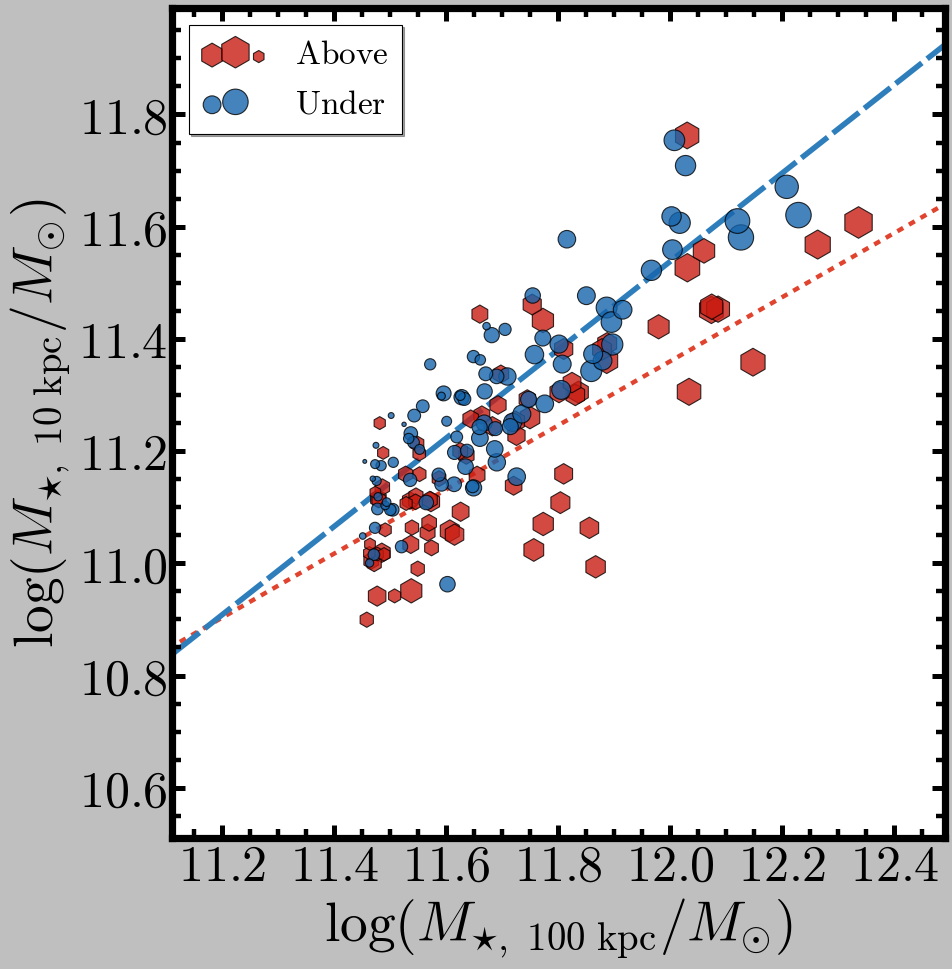

In [335]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

xx, yy = cat[above2]['m100_aper'], cat[above2]['m10_aper']
yyErr = yy * 0.0 + 0.03

A = np.vstack((np.ones_like(xx), xx)).T
C = np.diag(yyErr * yyErr)
cov = np.linalg.inv(np.dot(A.T, np.linalg.solve(C, A)))
bb1, aa1 = np.dot(cov, np.dot(A.T, np.linalg.solve(C, yy)))

ax1.scatter(cat[above2]['m100_aper'], cat[above2]['m10_aper'], marker='h', 
            s=(cat[above2]['logmhalo'] - 13.1) * 450, c=ORG(0.8), alpha=0.8, 
            label=r'$\mathrm{Above}$')

xx = np.linspace(11.0, 12.9, 200)
ax1.plot(xx, (xx * aa1 + bb1), c=ORG(0.7), linestyle='--', linewidth=4, zorder=0)

########

xx, yy = cat[under2]['m100_aper'], cat[under2]['m10_aper']
yyErr = yy * 0.0 + 0.03

A = np.vstack((np.ones_like(xx), xx)).T
C = np.diag(yyErr * yyErr)
cov = np.linalg.inv(np.dot(A.T, np.linalg.solve(C, A)))
bb2, aa2 = np.dot(cov, np.dot(A.T, np.linalg.solve(C, yy)))

ax1.scatter(cat[under2]['m100_aper'], cat[under2]['m10_aper'], 
            s=(cat[under2]['logmhalo'] - 13.1) * 450, c=BLU(0.8), alpha=0.8, 
            label=r'$\mathrm{Under}$')

xx = np.linspace(11.0, 12.9, 200)
ax1.plot(xx, (xx * aa2 + bb2), c=BLU(0.7), linestyle='--', linewidth=5.0, dashes=(30, 6), zorder=0)

ax1.set_xlabel('$\log (M_{\star,\ 100\ \mathrm{kpc}}/M_{\odot})$', size=50)
ax1.set_ylabel('$\log (M_{\star,\ 10\ \mathrm{kpc}}/M_{\odot})$', size=50)

legend = ax1.legend(loc='upper left', shadow=True, fontsize=30)

# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(11.11, 12.49)
ax1.set_ylim(10.51, 11.99)

fig.savefig('mblack2_m100_m10_z0.30_1.pdf', dpi=80)

In [293]:
homeDir = os.getenv('HOME')
ancDir = os.path.join(homeDir, 'astro4/massive/dr15b/note/ancil')

accFrac1 = Table.read(os.path.join(ancDir, 'illustris_accfrac_1.txt'), format='ascii')
accFrac2 = Table.read(os.path.join(ancDir, 'illustris_accfrac_2.txt'), format='ascii')
accFrac3 = Table.read(os.path.join(ancDir, 'illustris_accfrac_3.txt'), format='ascii')

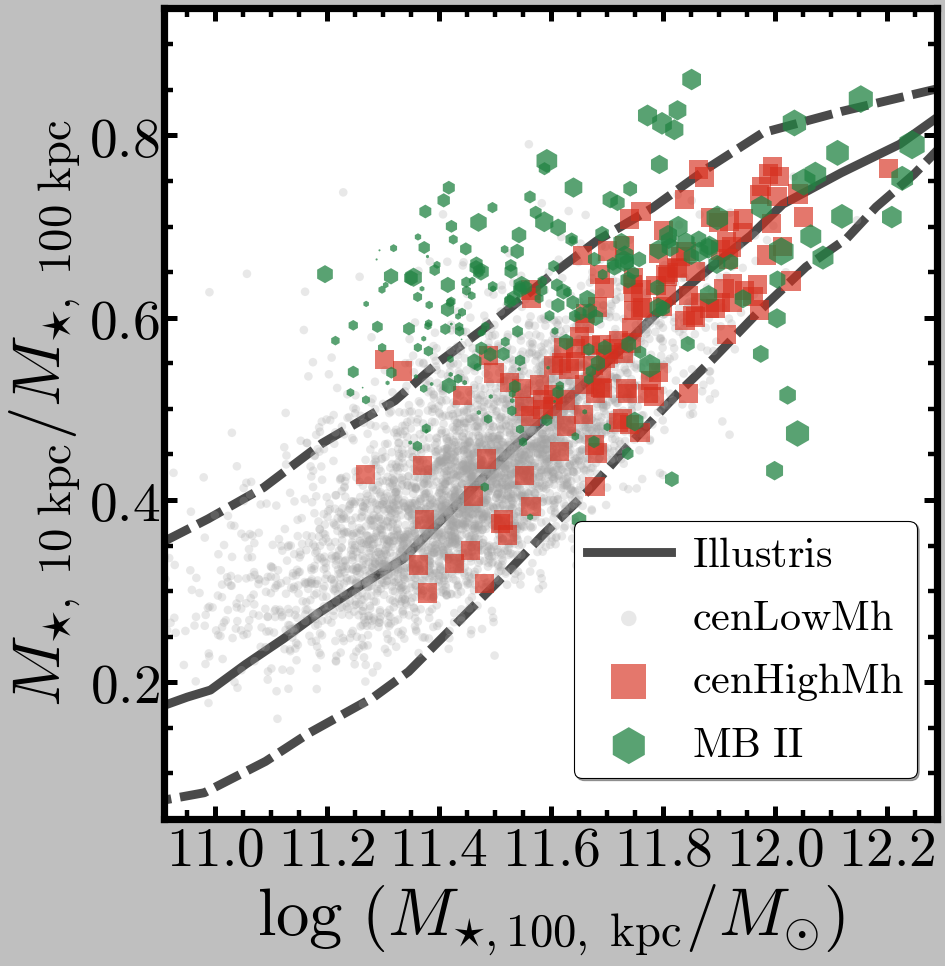

In [299]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.15, top=0.995,
                    wspace=0.00, hspace=0.00)

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=50, ylabel=50, border=6.5,
                    xtickFormat='$\mathrm{%4.1f}$', ytickFormat='$\mathrm{%3.1f}$')

ax1.scatter(nonbcgCleanU['logm_100'], 
            1.0 - 10.0 ** (nonbcgCleanU['logm_10'] - nonbcgCleanU['logm_100']) ,
            marker='o', edgecolor='none', cmap=BLK, s=60,
            c=BLK(0.45), 
            alpha=0.25, label='$\mathrm{cenLowMh}$',
            rasterized=True)
ax1.scatter(redbcgCleanU['logm_100'], 
            1.0 - 10.0 ** (redbcgCleanU['logm_10'] - redbcgCleanU['logm_100']) ,
            marker='s', edgecolor='none', cmap=ORG, s=300,
            c=ORG(0.75), 
            alpha=0.65, label='$\mathrm{cenHighMh}$',
            rasterized=True)

ax1.scatter(cat['m100_ellip'], 
            1.0 - 10.0 ** (cat['m10_aper'] - cat['m100_ellip']) ,
            marker='h', edgecolor='none', cmap=GRN, s=(cat['logmhalo'] - 13.25) * 500,
            c=GRN(0.75), 
            alpha=0.75, label='$\mathrm{MB\ II}$',
            rasterized=True)

# X, Y Label
ax1.set_xlabel('$\log\ ({M_{\star, \mathrm{100,\ kpc}}}/M_{\odot})$', 
               size=60)
ax1.set_ylabel('${M_{\star,\ \mathrm{10\ kpc}}}/M_{\star,\ \mathrm{100\ kpc}}$', 
               size=60)

# X, Y limits
ax1.set_ylim(0.05, 0.94)
ax1.set_xlim(10.91, 12.29)

# Overplot Mass-Size relation from Huertas-Company+13: 
ax1.plot(np.log10(accFrac1['mass']), accFrac1['frac'], 
         linestyle='-', linewidth=8.0, alpha=0.8,
         c=BLK(0.9), label='$\mathrm{Illustris}$', zorder=0)
ax1.plot(np.log10(accFrac2['mass']), accFrac2['frac'], 
         linestyle='--', linewidth=8.0, alpha=0.8,
         c=BLK(0.9), dashes=(25,8), zorder=0, label='_nolegend_')
ax1.plot(np.log10(accFrac3['mass']), accFrac3['frac'], 
         linestyle='--', linewidth=8.0, alpha=0.8,
         c=BLK(0.9), dashes=(25,8), zorder=0, label='_nolegend_')

# Legend
l_handles, l_labels = ax1.get_legend_handles_labels()
ax1.legend(l_handles, l_labels, loc=(0.53, 0.05),
           shadow=True, fancybox=True, 
           numpoints=1, fontsize=38, scatterpoints=1, 
           markerscale=1.8, borderpad=0.3, handletextpad=0.5)
legend = ax1.get_legend()

ax1.axvline(14.50, linestyle='--', linewidth=5.0, alpha=0.7, c=BROWN0)
ax1.axvline(14.60, linestyle='--', linewidth=5.0, alpha=0.7, c=BROWN0)

#-----------------------------------------------------------------#
fig.savefig('mblack2_logm100_logm100-10_1.pdf', dpi=90)

plt.show()

In [242]:
cat.write('mblack2_logms11.4_aperture.fits', format='fits', overwrite=True)

In [6]:
cat = Table.read('mblack2_logms11.4_aperture.fits', format='fits')

In [7]:
from cap_loess_2d import loess_2d
from cap_plot_velfield import plot_velfield

from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.ticker import MaxNLocator

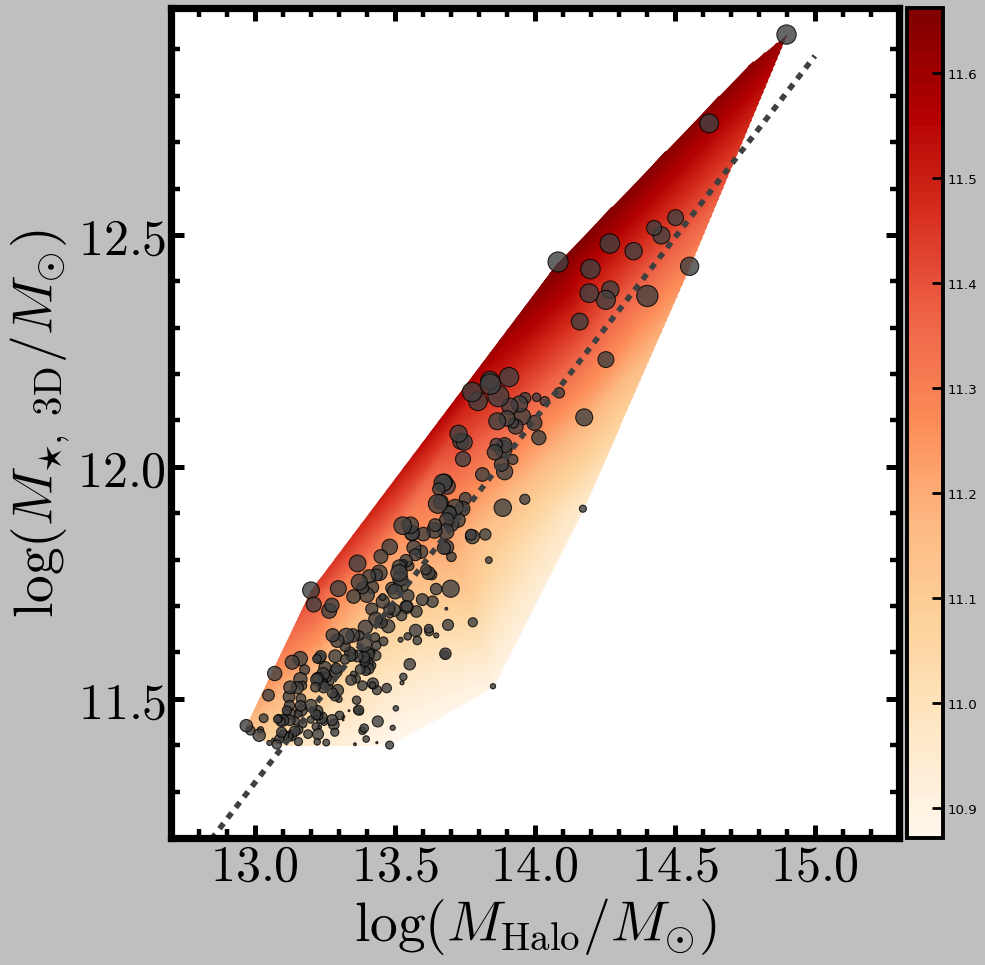

In [67]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

# Color countour
# --------------------------------------------------------------------------------------- #
xx = np.asarray(cat['logmhalo'])
yy = np.asarray(cat['logmstar'])
zz = np.asarray(cat['m10_aper'])
sigz = zz * 0.0 + 0.02
zout, wout = loess_2d(xx, yy, zz, degree=1, sigz=sigz)
# --------------------------------------------------------------------------------------- #

# --------------------------------------------------------------------------------------- #
xShow, yShow, zShow = map(np.ravel, [xx, yy, zout])
zMin, zMax = np.nanmin(zShow), np.nanmax(zShow)
nColors = 100
nTicks = 10
cLevels = np.linspace(zMin, zMax, nColors)

zContour = ax1.tricontourf(xShow, yShow, zShow, levels=cLevels, 
                           cmap=ORG, extend='neither')
for c in zContour.collections:    # Remove white gaps in contour levels of PDF
    c.set_edgecolor("face")       # http://stackoverflow.com/a/32911283/
    
divider = make_axes_locatable(ax1)
cax = divider.append_axes("right", size="5%", pad=0.1)
cTicks = MaxNLocator(nTicks).tick_values(zMin, zMax)
cbar = plt.colorbar(zContour, cax=cax, ticks=cTicks)
cbar.solids.set_edgecolor("face")  # Remove gaps in PDF http://stackoverflow.com/a/15021541
# --------------------------------------------------------------------------------------- #

# Scatter plot
xx, yy = cat['logmhalo'], cat['logmstar']
yyErr = yy * 0.0 + 0.03

A = np.vstack((np.ones_like(xx), xx)).T
C = np.diag(yyErr * yyErr)
cov = np.linalg.inv(np.dot(A.T, np.linalg.solve(C, A)))
bb1, aa1 = np.dot(cov, np.dot(A.T, np.linalg.solve(C, yy)))

ax1.scatter(cat['logmhalo'], cat['logmstar'], marker='o',
            s=(cat['m10_aper'] - 10.85) * 400,
            c=BLK(0.8), alpha=0.8)

xx = np.linspace(12.0, 15.0, 200)
yy = aa1 * xx + bb1
ax1.plot(xx, yy, linestyle='--', linewidth=5, c=BLK(0.8))

# 
ax1.set_xlabel('$\log (M_{\mathrm{Halo}}/M_{\odot})$', size=50)
ax1.set_ylabel('$\log (M_{\star,\ \mathrm{3D}}/M_{\odot})$', size=50)

# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(12.7, 15.3)
ax1.set_ylim(11.2, 12.99)

#legend = ax1.legend(loc='upper left', shadow=True, fontsize=30)

fig.savefig('mblack2_mhalo_mstar_z0.30_loess.pdf', dpi=80)

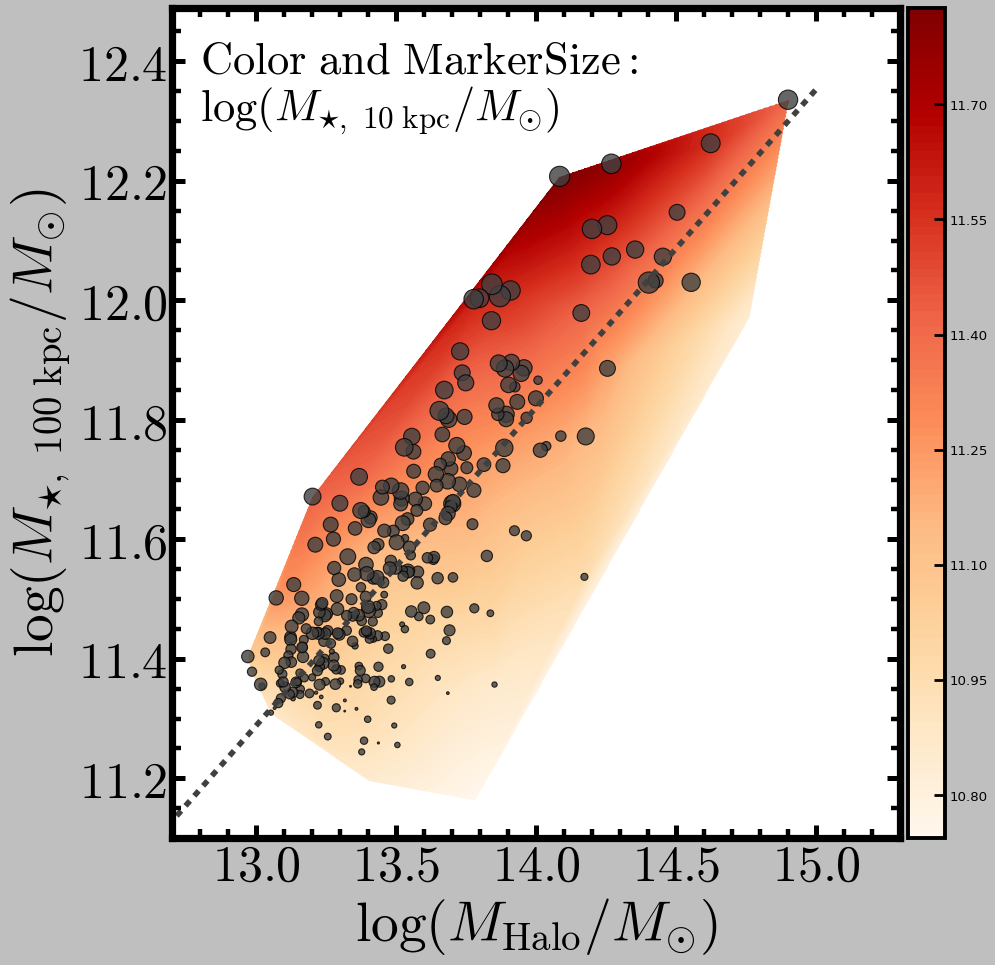

In [83]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

# Color countour
# --------------------------------------------------------------------------------------- #
xx = np.asarray(cat['logmhalo'])
yy = np.asarray(cat['m100_aper'])
zz = np.asarray(cat['m10_aper'])
sigz = zz * 0.0 + 0.02
zout, wout = loess_2d(xx, yy, zz, degree=2, sigz=sigz)
# --------------------------------------------------------------------------------------- #

# --------------------------------------------------------------------------------------- #
xShow, yShow, zShow = map(np.ravel, [xx, yy, zout])
zMin, zMax = np.nanmin(zShow), np.nanmax(zShow)
nColors = 100
nTicks = 10
cLevels = np.linspace(zMin, zMax, nColors)

zContour = ax1.tricontourf(xShow, yShow, zShow, levels=cLevels, 
                           cmap=ORG, extend='neither')
for c in zContour.collections:    # Remove white gaps in contour levels of PDF
    c.set_edgecolor("face")       # http://stackoverflow.com/a/32911283/
    
divider = make_axes_locatable(ax1)
cax = divider.append_axes("right", size="5%", pad=0.1)
cTicks = MaxNLocator(nTicks).tick_values(zMin, zMax)
cbar = plt.colorbar(zContour, cax=cax, ticks=cTicks)
cbar.solids.set_edgecolor("face")  # Remove gaps in PDF http://stackoverflow.com/a/15021541
# --------------------------------------------------------------------------------------- #

# Scatter plot
xx, yy = cat['logmhalo'], cat['m100_aper']
yyErr = yy * 0.0 + 0.03

A = np.vstack((np.ones_like(xx), xx)).T
C = np.diag(yyErr * yyErr)
cov = np.linalg.inv(np.dot(A.T, np.linalg.solve(C, A)))
bb1, aa1 = np.dot(cov, np.dot(A.T, np.linalg.solve(C, yy)))

ax1.scatter(cat['logmhalo'], cat['m100_aper'], marker='o',
            s=(cat['m10_aper'] - 10.85) * 400,
            c=BLK(0.8), alpha=0.8)

xx = np.linspace(12.0, 15.0, 200)
yy = aa1 * xx + bb1
ax1.plot(xx, yy, linestyle='--', linewidth=5, c=BLK(0.8))

# 
ax1.set_xlabel('$\log (M_{\mathrm{Halo}}/M_{\odot})$', size=50)
ax1.set_ylabel('$\log (M_{\star,\ \mathrm{100\ kpc}}/M_{\odot})$', size=50)

ax1.text(12.8, 12.38, r'$\mathrm{Color\ and\ Marker Size:}$', size=40)
ax1.text(12.8, 12.30, r'$\log (M_{\star,\ \mathrm{10\ kpc}}/M_{\odot})$', size=40)
    
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(12.7, 15.3)
ax1.set_ylim(11.1, 12.49)

#legend = ax1.legend(loc='upper left', shadow=True, fontsize=30)

fig.savefig('mblack2_mhalo_m100_z0.30_loess.pdf', dpi=80)

In [78]:
catC = copy.deepcopy(cat)

catC = catC[(catC['m10_aper'] > 10.2) & (catC['logmhalo'] <= 14.4)]

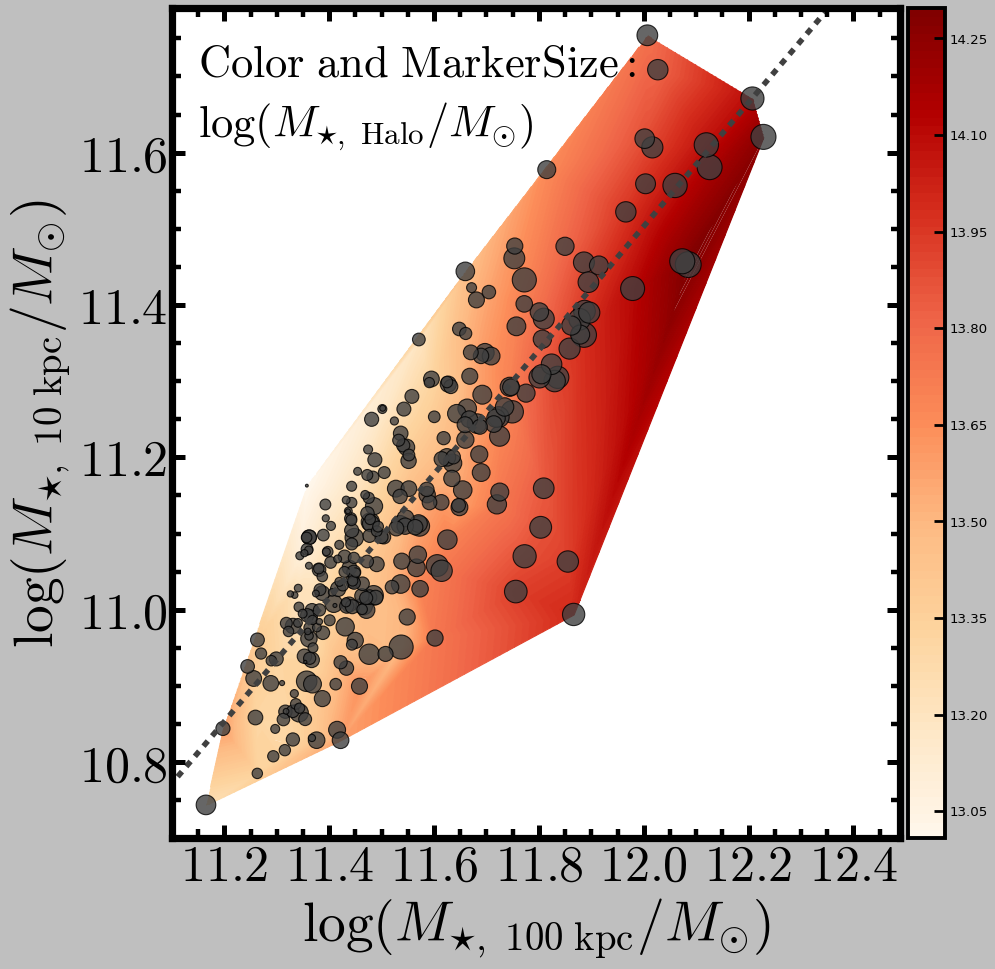

In [87]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

# Color countour
# --------------------------------------------------------------------------------------- #
xx = np.asarray(catC['m100_aper'])
yy = np.asarray(catC['m10_aper'])
zz = np.asarray(catC['logmhalo'])
sigz = zz * 0.0 + 0.02
zout, wout = loess_2d(xx, yy, zz, degree=2, sigz=sigz)
# --------------------------------------------------------------------------------------- #

# --------------------------------------------------------------------------------------- #
xShow, yShow, zShow = map(np.ravel, [xx, yy, zout])
zMin, zMax = np.nanmin(zShow), np.nanmax(zShow)
nColors = 100
nTicks = 10
cLevels = np.linspace(zMin, zMax, nColors)

zContour = ax1.tricontourf(xShow, yShow, zShow, levels=cLevels, 
                           cmap=ORG, extend='neither')
for c in zContour.collections:    # Remove white gaps in contour levels of PDF
    c.set_edgecolor("face")       # http://stackoverflow.com/a/32911283/
    
divider = make_axes_locatable(ax1)
cax = divider.append_axes("right", size="5%", pad=0.1)
cTicks = MaxNLocator(nTicks).tick_values(zMin, zMax)
cbar = plt.colorbar(zContour, cax=cax, ticks=cTicks)
cbar.solids.set_edgecolor("face")  # Remove gaps in PDF http://stackoverflow.com/a/15021541
# --------------------------------------------------------------------------------------- #

# Scatter plot
xx, yy = catC['m100_aper'], catC['m10_aper']
yyErr = yy * 0.0 + 0.02

A = np.vstack((np.ones_like(xx), xx)).T
C = np.diag(yyErr * yyErr)
cov = np.linalg.inv(np.dot(A.T, np.linalg.solve(C, A)))
bb1, aa1 = np.dot(cov, np.dot(A.T, np.linalg.solve(C, yy)))

ax1.scatter(catC['m100_aper'], catC['m10_aper'], marker='o',
            s=(catC['logmhalo'] - 13.00) * 400,
            c=BLK(0.8), alpha=0.8)

xx = np.linspace(10.0, 15.0, 200)
yy = aa1 * xx + bb1
ax1.plot(xx, yy, linestyle='--', linewidth=5, c=BLK(0.8))

# 
ax1.set_xlabel('$\log (M_{\star,\ \mathrm{100\ kpc}}/M_{\odot})$', size=50)
ax1.set_ylabel('$\log (M_{\star,\ \mathrm{10\ kpc}}/M_{\odot})$', size=50)

ax1.text(11.15, 11.70, r'$\mathrm{Color\ and\ Marker Size:}$', size=40)
ax1.text(11.15, 11.62, r'$\log (M_{\star,\ \mathrm{Halo}}/M_{\odot})$', size=40)

# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(11.1, 12.49)
ax1.set_ylim(10.7, 11.79)

#legend = ax1.legend(loc='upper left', shadow=True, fontsize=30)

fig.savefig('mblack2_m100_m10_z0.30_loess.pdf', dpi=80)

In [123]:
"""
Partial Correlation in Python

Based on Fabian Pedregosa-Izquierdo's implementation at:
https://gist.github.com/fabianp/9396204419c7b638d38f

This version of the algorithm calculates the partial correlation coefficient controlling for Z.
I use row vectors here, for whatever reason.
"""

"""
def partial_corr(X,Z):
	# Returns the partial correlation coefficients between elements of X controlling for the elements in Z.
    
	X = np.asarray(X).transpose()
	Z = np.asarray(Z).transpose()
	n = X.shape[1]

	partial_corr = np.zeros((n,n), dtype=np.float)
	for i in range(n):
		partial_corr[i,i] = 1
		for j in range(i+1,n):
			beta_i = np.linalg.lstsq(Z, X[:,j])[0]
			beta_j = np.linalg.lstsq(Z, X[:,i])[0]

			res_j = X[:,j] - Z.dot(beta_i)
			res_i = X[:,i] - Z.dot(beta_j)

			corr = np.corrcoef(res_i,res_j)

			partial_corr[i,j] = corr.item(0,1)
			partial_corr[j,i] = corr.item(0,1)

	return partial_corr
"""
    
from scipy import stats, linalg

def partial_corr(C):
    """
    Returns the sample linear partial correlation coefficients between pairs of variables in C, controlling 
    for the remaining variables in C.
    Parameters
    ----------
    C : array-like, shape (n, p)
        Array with the different variables. Each column of C is taken as a variable
    Returns
    -------
    P : array-like, shape (p, p)
        P[i, j] contains the partial correlation of C[:, i] and C[:, j] controlling
        for the remaining variables in C.
    """
    
    C = np.asarray(C)
    p = C.shape[1]
    P_corr = np.zeros((p, p), dtype=np.float)
    for i in range(p):
        P_corr[i, i] = 1
        for j in range(i+1, p):
            idx = np.ones(p, dtype=np.bool)
            idx[i] = False
            idx[j] = False
            beta_i = linalg.lstsq(C[:, idx], C[:, j])[0]
            beta_j = linalg.lstsq(C[:, idx], C[:, i])[0]

            res_j = C[:, j] - C[:, idx].dot( beta_i)
            res_i = C[:, i] - C[:, idx].dot(beta_j)
            
            corr = stats.pearsonr(res_i, res_j)[0]
            P_corr[i, j] = corr
            P_corr[j, i] = corr
        
    return P_corr

In [134]:
xx1 = catC['logmhalo'].data
xx2 = catC['logmstar'].data
zz = catC['m10_aper'].data
XX = np.asarray(map(lambda x, y, z: [x, y, z], xx1, xx2, zz))

partial_corr(XX)

array([[ 1.        ,  0.87428069, -0.29484646],
       [ 0.87428069,  1.        ,  0.7215291 ],
       [-0.29484646,  0.7215291 ,  1.        ]])

In [135]:
XXstd = XX.copy()
XXstd -= XX.mean(axis=0)[np.newaxis, :] 
XXstd /= XX.std(axis=0)[np.newaxis, :]

partial_corr(XXstd)

array([[ 1.        ,  0.89388715, -0.51991416],
       [ 0.89388715,  1.        ,  0.75036583],
       [-0.51991416,  0.75036583,  1.        ]])

In [136]:
xx1 = catC['logmhalo'].data
xx2 = catC['m100_aper'].data
zz = catC['m10_aper'].data
XX = np.asarray(map(lambda x, y, z: [x, y, z], xx1, xx2, zz))

partial_corr(XX)

array([[ 1.        ,  0.78190624, -0.46079363],
       [ 0.78190624,  1.        ,  0.91352271],
       [-0.46079363,  0.91352271,  1.        ]])

In [137]:
XXstd = XX.copy()
XXstd -= XX.mean(axis=0)[np.newaxis, :] 
XXstd /= XX.std(axis=0)[np.newaxis, :]

partial_corr(XXstd)

array([[ 1.        ,  0.77241308, -0.50918004],
       [ 0.77241308,  1.        ,  0.86743763],
       [-0.50918004,  0.86743763,  1.        ]])

## Extract the Ellipticity Profile

!!! DANGEROUS : Outer boundary is not safe !!!
!!! DANGEROUS : Outer boundary is not safe !!!


/Users/song/Dropbox/work/project/hs_hsc/py/galsbp/galSBP.py:793: RuntimeWarning: Mean of empty slice
  outRsma = np.nanmean(negRad)


!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
###  ELLIPSE RUN FAILED IN ATTEMPT:  0
###  Error Information :  XXX Can not find the outBin: maps/stellar_central/map_67_conv_ellip_2.bin!
!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
----------------------------------------------------------------------------------------------------
###  Maxsma  105.0 -->   94.5
----------------------------------------------------------------------------------------------------
!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
###  ELLIPSE RUN FAILED IN ATTEMPT:  1
###  Error Information :  XXX Can not find the outBin: maps/stellar_central/map_67_conv_ellip_2.bin!
!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
------------------------------------------------------------------------------------

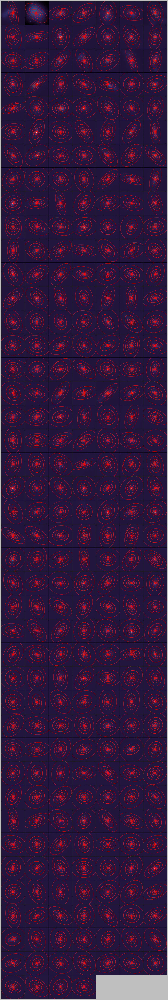

In [89]:
# Prepare the plot
fig = plt.figure(figsize=(14, 84))
fig.subplots_adjust(left=0.0, right=1.0, 
                    bottom=0.0, top=1.0,
                    wspace=0.00, hspace=0.00)

gs = gridspec.GridSpec(42, 7)
gs.update(wspace=0.0, hspace=0.00)

xArr, yArr, ba1Arr, pa1Arr, ba2Arr, pa2Arr, ba3Arr, pa3Arr = [], [], [], [], [], [], [], []
smaProf, ellProf, paProf, sbpProf = [], [], [], []


for ii in range(nSample):
    # Image
    msFile = os.path.join(msDir, 'map_' + str(ii).strip() + '.fits')
    galID = ii
    img = fits.open(msFile)[0].data
    imgN = img.byteswap().newbyteorder()
    
    col = cat[ii]

    imgSave = os.path.join(msDir, 'map_' + str(ii).strip() + '_conv.fits')
    imgC = ndimage.convolve(imgN, kernel2, mode='constant', cval=0.0) 
    
    hdu = fits.PrimaryHDU(imgC)
    hdulist = fits.HDUList([hdu])
    hdulist.writeto(imgSave, clobber=True)

    try:
        ellOut, binOut = galSBP.galSBP(imgSave, galX=cenX, galY=cenY, 
                                       maxSma=105, iniSma=7.0, 
                                       verbose=False, savePng=False, saveOut=False,
                                       useZscale=False, expTime=1.0, pix=scale, zpPhoto=0.0,
                                       galQ=col['ba_aper'], galPA=col['pa_aper'], 
                                       stage=2, minSma=0.0, ellipStep=0.1,
                                       isophote=isophote, xttools=xttools, 
                                       uppClip=9.0, lowClip=9.0, fracBad=0.6,
                                       harmonics="none", maxTry=9, olthresh=0.2,
                                       nClip=0, intMode='median', updateIntens=False)
    except Exception:
        ellOut, binOut = None, None

    # Show the aperture
    ax = plt.subplot(gs[ii])
    ax.yaxis.set_major_formatter(NullFormatter())
    ax.xaxis.set_major_formatter(NullFormatter())

    m, s = np.mean(imgC), np.std(imgC)
    im = ax.imshow(imgC, interpolation='nearest', cmap=CUBE,
                   vmin=m-1.5*s, vmax=m+10*s, origin='lower')
    
    if ellOut is not None:
        # Estimate the average ellipticity and position angle 
        sma = ellOut['sma']
        kpc = sma * scale
        xArr.append(ellOut[1]['x0'])
        yArr.append(ellOut[1]['y0'])

        avgEll1 = np.nanmedian(ellOut['ell'][(kpc > 6.0) & (kpc < 30.0)])
        avgPA1 = np.nanmedian(ellOut['pa'][(kpc > 6.0) & (kpc < 30.0)])
        ba1Arr.append(1.0 - avgEll1)
        pa1Arr.append(avgPA1)
        avgEll2 = np.nanmedian(ellOut['ell'][(kpc > 30.0) & (kpc < 50.0)])
        avgPA2 = np.nanmedian(ellOut['pa'][(kpc > 30.0) & (kpc < 50.0)])
        ba2Arr.append(1.0 - avgEll2)
        pa2Arr.append(avgPA2)
        avgEll3 = np.nanmedian(ellOut['ell'][(kpc > 50.0) & (kpc < 120.0)])
        avgPA3 = np.nanmedian(ellOut['pa'][(kpc > 50.0) & (kpc < 120.0)])
        ba3Arr.append(1.0 - avgEll3)
        pa3Arr.append(avgPA3)

        # Ellipticity and position angle profiles
        smaProf.append(np.asarray(kpc))
        ellProf.append(np.asarray(ellOut['ell']))
        paProf.append(np.asarray(ellOut['pa']))
        sbpProf.append(np.asarray(ellOut['sbp']))

        # plot an ellipse for each object
        for i in range(len(objects)):
            for k, iso in enumerate(ellOut):
                if k % 5 == 0:
                    e = Ellipse(xy=(iso['x0'], iso['y0']),
                                height=iso['sma'] * 2.0,
                                width=iso['sma'] * 2.0 * (1.0 - iso['ell']),
                                angle=iso['pa'])
                e.set_facecolor('none')
                e.set_edgecolor('r')
                e.set_alpha(0.20)
                ax.add_artist(e)
        ax.set_aspect('equal')
    else: 
        xArr.append(None)
        yArr.append(None)
        ba1Arr.append(None)
        pa1Arr.append(None)
        ba2Arr.append(None)
        pa2Arr.append(None)            
        ba3Arr.append(None)
        pa3Arr.append(None)
        smaProf.append(None)
        ellProf.append(None)
        paProf.append(None)
        sbpProf.append(None)            
        
fig.savefig('mblack2_map_ellip_step2_z0.30.pdf', dpi=100)

In [243]:
cat['xCen_ellip'] = Column(xArr, description='X center using Ellipse')
cat['yCen_ellip'] = Column(xArr, description='Y center using Ellipse')

cat['ba1_ellip'] = Column(ba1Arr, description='b/a using Ellipse/ < 30 kpc ')
cat['ba2_ellip'] = Column(ba2Arr, description='b/a using Ellipse/ < 50 kpc ')
cat['ba3_ellip'] = Column(ba3Arr, description='b/a using Ellipse/ < 120 kpc ')
cat['pa1_ellip'] = Column(pa1Arr, description='PA using Ellipse/ < 30 kpc ')
cat['pa2_ellip'] = Column(pa2Arr, description='PA using Ellipse/ < 50 kpc ')
cat['pa3_ellip'] = Column(pa3Arr, description='PA using Ellipse/ < 120 kpc ')

cat['sma2'] = Column(smaProf, description='Array of major axis distance/ Step2')
cat['ell_prof'] = Column(ellProf, description='Ellipticity proifile/ Step2')
cat['pa_prof'] = Column(paProf, description='Position angle proifile/ Step2')
cat['sbp2_prof'] = Column(sbpProf, description='Surface density proifile/ Step2')

In [244]:
catB = copy.deepcopy(cat)

catB.remove_columns(['sma2', 'ell_prof', 'pa_prof', 'sbp2_prof'])

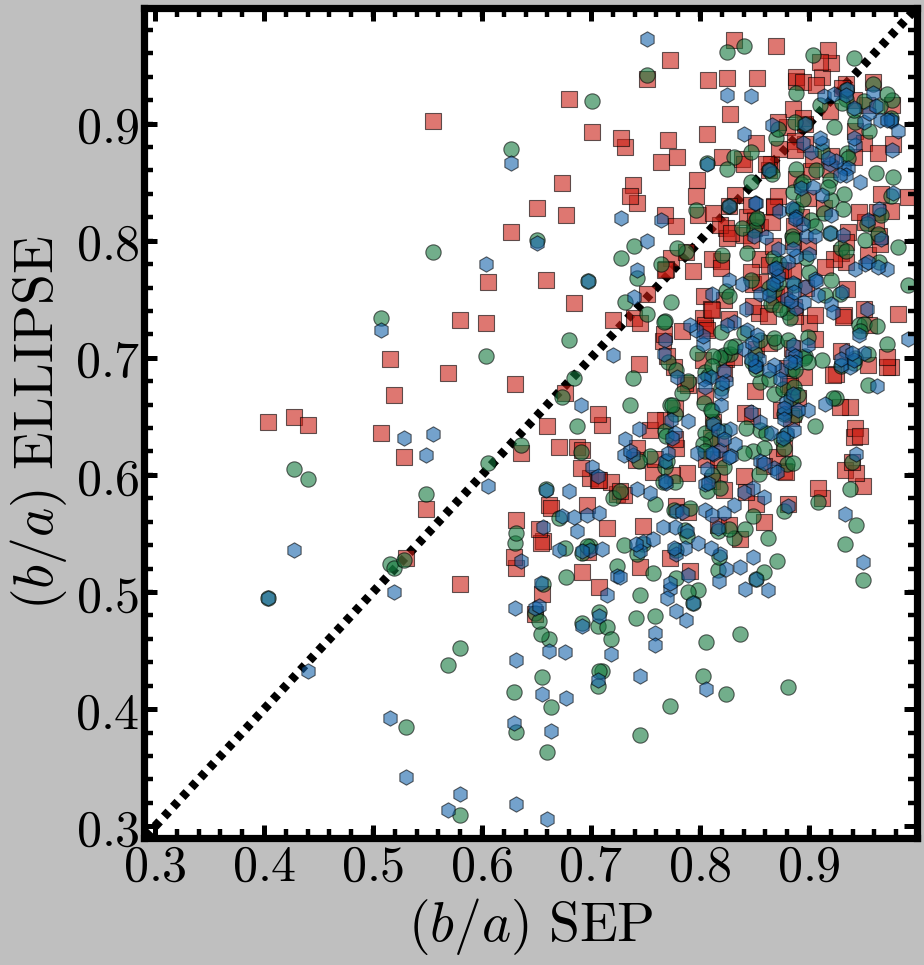

In [206]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

ax1.scatter(cat['ba_aper'], cat['ba1_ellip'], s=190, c=ORG(0.8), alpha=0.6, marker='s')
ax1.scatter(cat['ba_aper'], cat['ba2_ellip'], s=190, c=GRN(0.8), alpha=0.6, marker='o')
ax1.scatter(cat['ba_aper'], cat['ba3_ellip'], s=190, c=BLU(0.8), alpha=0.6, marker='h')

ax1.plot(np.asarray([0.2, 1.0]), np.asarray([0.2, 1.0]), linestyle='--', linewidth=8, c='k', zorder=0)

ax1.set_xlabel('$(b/a)\ \mathrm{SEP}$', size=50)
ax1.set_ylabel('$(b/a)\ \mathrm{ELLIPSE}$', size=50)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(0.29, 0.999)
ax1.set_ylim(0.29, 0.999)

fig.savefig('mblack2_ba_compare_z0.3.pdf', dpi=80)

In [245]:
catB.write('mblack2_logms11.4_ellip2.fits', format='fits', overwrite=True)

pklSave = open('mblack2_logms11.4_ellip2.pkl', 'wb')
pickle.dump(catB, pklSave)
pklSave.close()

# Extract suface mass density profiles 

!!! DANGEROUS : Outer boundary is not safe !!!
!!! DANGEROUS : Outer boundary is not safe !!!


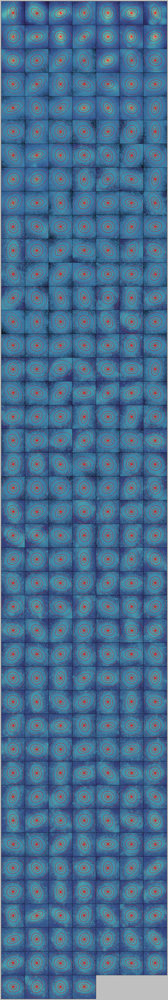

In [247]:
# Prepare the plot
fig = plt.figure(figsize=(14, 84))
fig.subplots_adjust(left=0.0, right=1.0, 
                    bottom=0.0, top=1.0,
                    wspace=0.00, hspace=0.00)

gs = gridspec.GridSpec(42, 7)
gs.update(wspace=0.0, hspace=0.00)

smaProf1, sbpProf1, cogProf1 = [], [], []
sbpProf2, cogProf2 = [], []

for ii in range(nSample):
    
    msFile = os.path.join(msDir, 'map_' + str(ii).strip() + '.fits')
    galID = ii
    img = fits.open(msFile)[0].data
    imgN = img.byteswap().newbyteorder()
    col = cat[ii]
    
    #imgSave = os.path.join(msDir, 'map_' + str(ii).strip() + '_cor.fits')
    #imgM = (imgN / h0)
    
    #hdu = fits.PrimaryHDU(imgM)
    #hdulist = fits.HDUList([hdu])
    #hdulist.writeto(imgSave, clobber=True)
    
    try:
        baUse = col['ba1_ellip']
        paUse = hUtil.normAngle(col['pa1_ellip'], lower=-90, upper=90, b=True)
        ellOut, binOut = galSBP.galSBP(msFile, galX=col['xCen_ellip'], galY=col['yCen_ellip'], 
                                       maxSma=95, iniSma=7.0, 
                                       verbose=False, savePng=False, saveOut=False,
                                       useZscale=False, expTime=1.0, pix=1.85, zpPhoto=0.0,
                                       galQ=baUse, galPA=paUse, useTflux=True,
                                       stage=3, minSma=0.0, ellipStep=0.12,
                                       isophote=isophote, xttools=xttools, 
                                       fracBad=0.6, uppClip=6.0, lowClip=6.0, maxTry=9,
                                       nClip=0, intMode='median', updateIntens=False)
    except Exception:
        warnings.warn("!!! Ellipse run failed on: %s" % imgSave)
        ellOut, binOut = None, None

    # Show the aperture
    ax = plt.subplot(gs[ii])
    ax.yaxis.set_major_formatter(NullFormatter())
    ax.xaxis.set_major_formatter(NullFormatter())

    imgN = np.arcsinh(imgN)
    m, s = np.nanmean(imgN), np.nanstd(imgN)
    im = ax.imshow(imgN, interpolation='nearest', cmap=CUBE,
                   vmin=m-3.5*s, vmax=m+5*s, origin='lower')
    
    if ellOut is not None:
        # Estimate the average ellipticity and position angle 
        sma = ellOut['sma']
        kpc = sma * scale

        # Ellipticity and position angle profiles
        smaProf1.append(np.asarray(kpc))
        cogProf1.append(np.asarray(ellOut['growth_ori']))
        sbpProf1.append(np.asarray(ellOut['sbp_ori']) / -2.5)
        cogProf2.append(np.asarray(ellOut['growth_cor']))
        sbpProf2.append(np.asarray(ellOut['sbp']) / -2.5)

        # plot an ellipse for each object
        for i in range(len(objects)):
            for k, iso in enumerate(ellOut):
                if k % 5 == 0:
                    e = Ellipse(xy=(iso['x0'], iso['y0']),
                                height=iso['sma'] * 2.0,
                                width=iso['sma'] * 2.0 * (1.0 - iso['ell']),
                                angle=iso['pa'])
                e.set_facecolor('none')
                e.set_edgecolor('r')
                e.set_alpha(0.15)
                ax.add_artist(e)
        ax.set_aspect('equal')
    else: 
        # Ellipticity and position angle profiles
        smaProf1.append(None)
        cogProf1.append(None)
        sbpProf1.append(None)
        
fig.savefig('mblack2_map_ellip_step3_1_z0.3.pdf', dpi=100)

In [248]:
cat['sma3'] = Column(smaProf1, description='Major axis radius/ Step3')

cat['sbp3a_prof'] = Column(sbpProf1, description='Surface density profil/ Step3')
cat['cog3a_prof'] = Column(cogProf1, description='Curve of growth/ Step3')

cat['sbp3b_prof'] = Column(sbpProf2, description='Surface density profil/ Step3')
cat['cog3b_prof'] = Column(cogProf2, description='Curve of growth/ Step3')

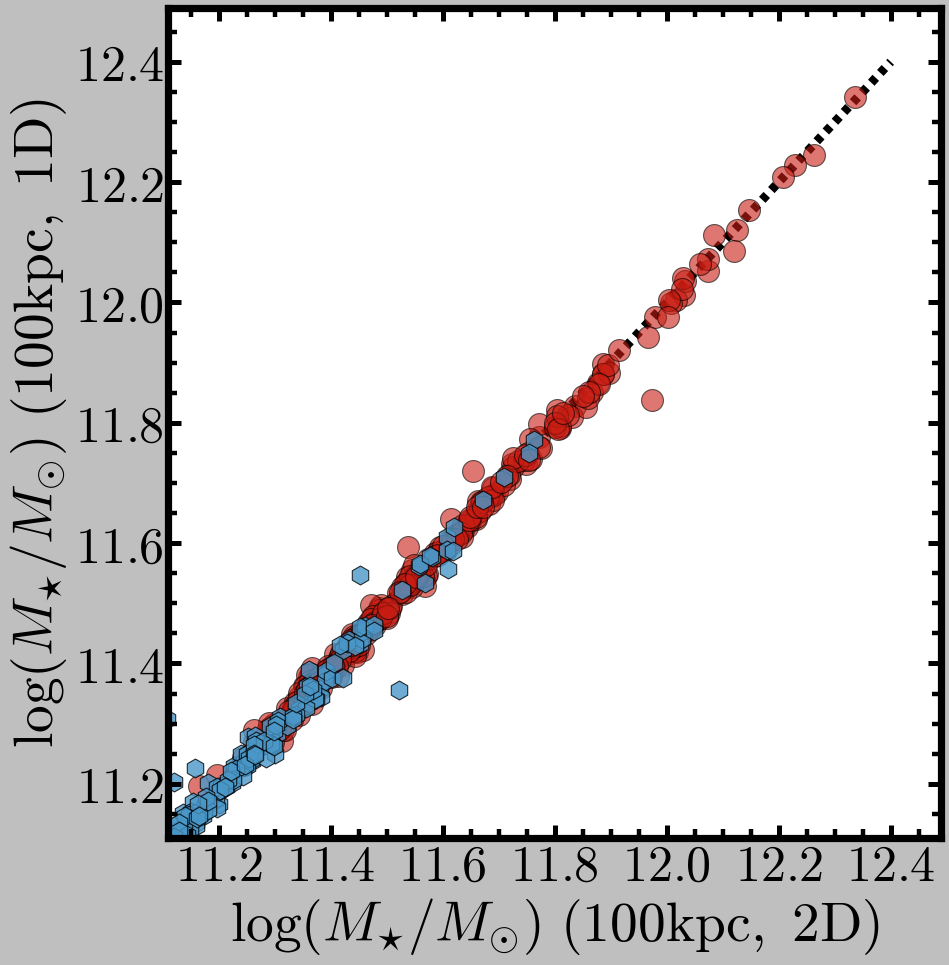

In [253]:
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.13, top=0.995,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

m10e, m30e, m50e, m100e, m120e, m150e = [], [], [], [], [], []
for gal in cat: 
    try:
        intrp = interp1d(gal['sma3'], gal['cog3a_prof'])
        m10e.append(np.log10(intrp(10.0) / h0))
        m30e.append(np.log10(intrp(30.0) / h0))
        m50e.append(np.log10(intrp(50.0) / h0))
        m100e.append(np.log10(intrp(100.0) / h0))
        m120e.append(np.log10(intrp(120.0) / h0))
        m150e.append(np.log10(intrp(150.0) / h0))
    except Exception:
        m10e.append(None)
        m30e.append(None)
        m50e.append(None)
        m100e.append(None)
        m120e.append(None)
        m150e.append(None)
        
m10e = np.asarray(m10e)
m30e = np.asarray(m30e)
m50e = np.asarray(m50e)
m100e = np.asarray(m100e)
m120e = np.asarray(m120e)
m150e = np.asarray(m150e)
    
ax1.scatter(cat['m100_aper'], m100e, s=390, c=ORG(0.8), alpha=0.6)

ax1.scatter(cat['m10_aper'], m10e, s=290, c=BLU(0.6), alpha=0.8, marker='h')

ax1.plot(np.asarray([11.1, 12.4]), np.asarray([11.1, 12.4]), linestyle='--', linewidth=8, c='k', zorder=0)

ax1.set_xlabel('$\log (M_{\star}/M_{\odot})\ (100 \mathrm{kpc},\ \mathrm{2D})$', size=50)
ax1.set_ylabel('$\log (M_{\star}/M_{\odot})\ (100 \mathrm{kpc},\ \mathrm{1D})$', size=50)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(11.11, 12.49)
ax1.set_ylim(11.11, 12.49)

fig.savefig('mblack_m100_compare_ellip_inner_z0.3.pdf', dpi=80)

In [252]:
cat['m10_ellip'] = Column(m10e, description='Mass within 10 kpc/ Ellipse')
cat['m30_ellip'] = Column(m30e, description='Mass within 30 kpc/ Ellipse')
cat['m50_ellip'] = Column(m50e, description='Mass within 50 kpc/ Ellipse')
cat['m100_ellip'] = Column(m100e, description='Mass within 100 kpc/ Ellipse')
cat['m120_ellip'] = Column(m120e, description='Mass within 120 kpc/ Ellipse')
cat['m150_ellip'] = Column(m150e, description='Mass within 150 kpc/ Ellipse')

# Compare with HSC

In [115]:
# Location of the data
homeDir = os.getenv('HOME')
sbpDir = os.path.join(homeDir, 'astro4/massive/dr15b/sbp/')

# Location for figures
figDir = os.path.join(sbpDir, 'figure')
# Location for subsamples
sampleDir = os.path.join(sbpDir, 'catalog')

masterDir = os.path.join(homeDir, 'astro4/massive/dr15b/master')

# The SED models 
# 'fsps1', 'fsps2', 'fsps3', 'fsps4', 'bc03a'
sedMod = 'fsps1'
# 'imgsub', 'img'
sbpType = 'imgsub'

# Catalog files for BCG and NonBCG
redbcgStr = 'dr1_redbcg_isedfit_mass_' + sedMod + '_sbpsum_' + sbpType + '_use'
nonbcgStr = 'dr1_nonbcg_isedfit_mass_' + sedMod + '_sbpsum_' + sbpType + '_use'
redmemStr = 'dr1_redmem_isedfit_mass_' + sedMod + '_sbpsum_' + sbpType + '_use'

redbcgFile = redbcgStr + '.fits' 
nonbcgFile = nonbcgStr + '.fits' 
redmemFile = redmemStr + '.fits'

# Output
redbcgPrep = redbcgFile.replace('.fits', '_prep.fits')
nonbcgPrep = nonbcgFile.replace('.fits', '_prep.fits')
redmemPrep = redmemFile.replace('.fits', '_prep.fits')

redbcgLab1 = '$\mathrm{cenLowMh}$'
redbcgLab2 = '$\mathrm{cenHighMh}$'
nonbcgLab = '$\mathrm{cenLowMh}$'

try:
    redbcgTab
except NameError:
    pass
else:
    del redbcgTab     
try:
    nonbcgTab
except NameError:
    pass
else:
    del nonbcgTab
    
# Location for the SBP summary file
redbcgDir = os.path.join(sbpDir, 'redbcg')
nonbcgDir = os.path.join(sbpDir, 'nonbcg')
redmemDir = os.path.join(sbpDir, 'redmem')

# Two summary catalogs
redbcgCat = os.path.join(sampleDir, redbcgFile)
nonbcgCat = os.path.join(sampleDir, nonbcgFile)
redmemCat = os.path.join(sampleDir, redmemFile)

prefix1 = 'redbcg'
prefix2 = 'nonbcg'
prefix3 = 'redmem'

In [116]:
# The CLEAN sample: 
redbcgClean = Table.read(os.path.join(sampleDir, redbcgFile.replace('.fits', '_clean.fits')), 
                         format='fits')
nonbcgClean = Table.read(os.path.join(sampleDir, nonbcgFile.replace('.fits', '_clean.fits')), 
                         format='fits')
redmemClean = Table.read(os.path.join(sampleDir, redmemFile.replace('.fits', '_clean.fits')), 
                         format='fits')

# The USE samples: 
redbcgUse = Table.read(os.path.join(sampleDir, redbcgFile.replace('.fits', '_use.fits')), 
                         format='fits')
nonbcgUse = Table.read(os.path.join(sampleDir, nonbcgFile.replace('.fits', '_use.fits')), 
                         format='fits')
redmemUse = Table.read(os.path.join(sampleDir, redmemFile.replace('.fits', '_use.fits')), 
                         format='fits')

# The GAMA sample
redbcgGama = Table.read(os.path.join(sampleDir, redbcgFile.replace('.fits', '_gama.fits')), 
                        format='fits')
nonbcgGama = Table.read(os.path.join(sampleDir, nonbcgFile.replace('.fits', '_gama.fits')), 
                        format='fits')

redbcgGamaZ = Table.read(os.path.join(sampleDir, redbcgFile.replace('.fits', '_gamaz.fits')), 
                         format='fits')
nonbcgGamaZ = Table.read(os.path.join(sampleDir, nonbcgFile.replace('.fits', '_gamaz.fits')), 
                         format='fits')

# Stripe 82 
s82data = Table.read(os.path.join(masterDir, 'dr1_s82_clean_zbin_isedfit_fsps2.fits'), 
                     format='fits')

In [294]:
redbcgCleanU = redbcgClean[redbcgClean['z_use'] > 0.3]
nonbcgCleanU = nonbcgClean[nonbcgClean['z_use'] > 0.3]

In [117]:
def loadPkl(filename):
    try:
        import cPickle as pickle
    except:
        warnings.warn("## cPickle is not available!!")
        import pickle
    
    if os.path.isfile(filename):
        pklFile = open(filename, 'rb')
        data = pickle.load(pklFile)    
        pklFile.close()
    
        return data
    else: 
        warnings.warn("## Can not find %s, return None" % filename)
        return None

redbcgProfMbin0 = loadPkl(os.path.join(redbcgDir, prefix1 + '_fsps1_MBin0_profs.pkl'))
redbcgProfMbin1 = loadPkl(os.path.join(redbcgDir, prefix1 + '_fsps1_MBin1_profs.pkl'))
redbcgProfMbin2 = loadPkl(os.path.join(redbcgDir, prefix1 + '_fsps1_MBin2_profs.pkl'))
redbcgProfMbin3 = loadPkl(os.path.join(redbcgDir, prefix1 + '_fsps1_MBin3_profs.pkl'))
nonbcgProfMbin0 = loadPkl(os.path.join(nonbcgDir, prefix2 + '_fsps1_MBin0_profs.pkl'))
nonbcgProfMbin1 = loadPkl(os.path.join(nonbcgDir, prefix2 + '_fsps1_MBin1_profs.pkl'))
nonbcgProfMbin2 = loadPkl(os.path.join(nonbcgDir, prefix2 + '_fsps1_MBin2_profs.pkl'))

In [118]:
aa = Table([redbcgClean['z_use'], redbcgClean['logm_100'], redbcgClean['MSTAR'], redbcgClean['logm_10']])
bb = Table([nonbcgClean['z_use'], nonbcgClean['logm_100'], nonbcgClean['MSTAR'], nonbcgClean['logm_10']])
#cc = Table([redmemClean['z_use'], redmemClean['logm_100'], redmemClean['MSTAR'], redmemClean['logm_150']])

from astropy.table import vstack
massAll = vstack([aa, bb])

sampleM100c = 'matchA_m100_' + sedMod
redbcgProfM100c = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100c + '_profs.pkl'))
nonbcgProfM100c = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100c + '_profs.pkl'))

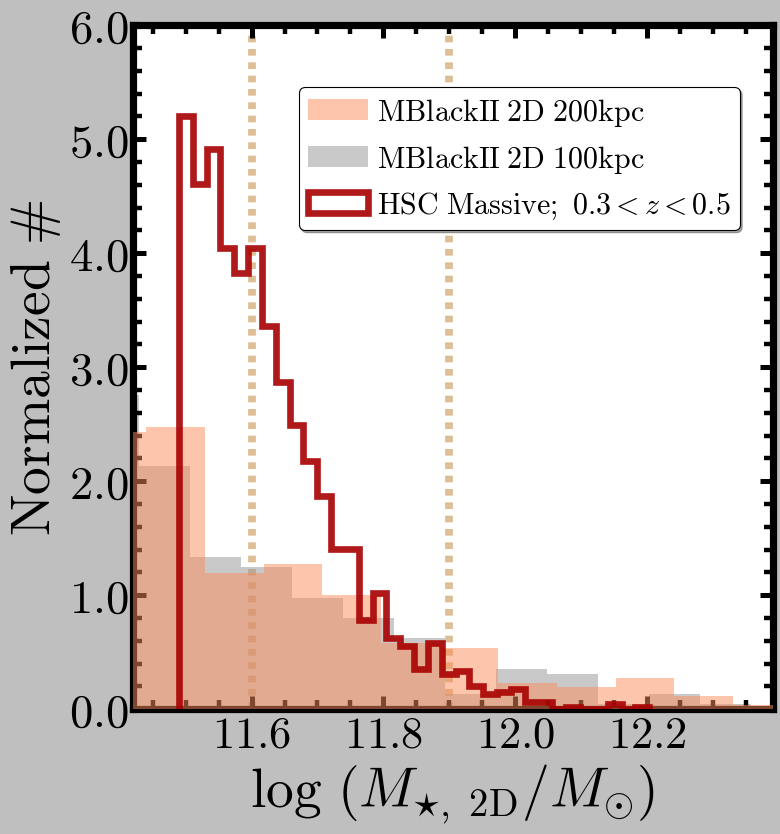

In [122]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 10))
fig.subplots_adjust(left=0.195, right=0.995, 
                    bottom=0.140, top=0.995,
                    wspace=0.02, hspace=0.00)
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=42, border=6.5,
                    xtickFormat='$\mathbf{%4.1f}$',
                    ytickFormat='$\mathbf{%4.1f}$')

nonbcgBin2 = nonbcgUse[(nonbcgUse['z_use'] >= 0.20)] 
redbcgBin2 = redbcgUse[(redbcgUse['z_use'] >= 0.20)] 

nonbcgBin = nonbcgUse[(nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
redbcgBin = redbcgUse[(redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

massHigh = massAll[(massAll['logm_100'] >= 11.49)]

temp = hist(cat['m150_ellip'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.5, color=ORG(0.5), edgecolor='none',
            normed=True, ax=ax1, zorder=3, rasterized=True,
            label='$\mathrm{MBlackII\; 2D\ 200\mathrm{kpc}}$')
temp = hist(cat['m100_ellip'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.5, color=BLK(0.5), edgecolor='none',
            normed=True, ax=ax1, zorder=1, rasterized=True,
            label='$\mathrm{MBlackII\; 2D\ 100\mathrm{kpc}}$')

temp = hist(massHigh['logm_100'], 
            bins='knuth', histtype='step', 
            alpha=0.9, color=ORG(0.9), linewidth=6.0,
            normed=True, ax=ax1, zorder=5, rasterized=True,
            label='$\mathrm{HSC\ Massive};\ 0.3 < z < 0.5$')

ax1.axvline(11.60, linestyle='--', linewidth=7.0, alpha=0.5, 
            c=BROWN0, zorder=0)
ax1.axvline(11.90, linestyle='--', linewidth=7.0, alpha=0.5, 
            c=BROWN0, zorder=0)

ax1.set_xlim(11.42, 12.39)
#ax1.set_ylim(0.01, 5.99)

ax1.set_xlabel('$\log\ ({M_{\star,\ 2\mathrm{D}}}/M_{\odot})$', 
               size=50)
ax1.set_ylabel('$\mathrm{Normalized\ \#}$', fontsize=50)

# Legend
ax1.legend(loc=(0.26, 0.70), shadow=True, fancybox=True, 
           numpoints=1, fontsize=27, scatterpoints=1, 
           markerscale=1.3, borderpad=0.3, handletextpad=0.3)
legend = ax1.get_legend()

fig.savefig('mblack2_logm100_hist_z0.3.pdf', dpi=80)

plt.show()

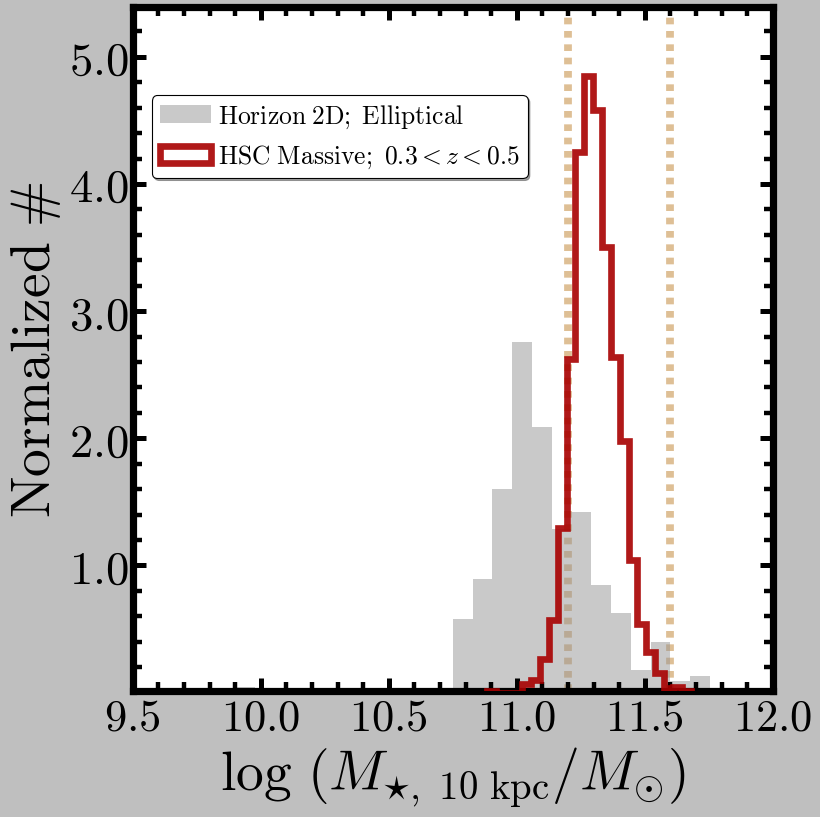

In [213]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 10))
fig.subplots_adjust(left=0.195, right=0.995, 
                    bottom=0.140, top=0.995,
                    wspace=0.02, hspace=0.00)
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=42, border=6.5,
                    xtickFormat='$\mathbf{%4.1f}$',
                    ytickFormat='$\mathbf{%4.1f}$')

nonbcgBin2 = nonbcgUse[(nonbcgUse['z_use'] >= 0.20)] 
redbcgBin2 = redbcgUse[(redbcgUse['z_use'] >= 0.20)] 

nonbcgBin = nonbcgUse[(nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
redbcgBin = redbcgUse[(redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

massHigh = massAll[(massAll['logm_100'] >= 11.45)]

temp = hist(cat['m10_ellip'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.5, color=BLK(0.5), edgecolor='none',
            normed=True, ax=ax1, zorder=1, rasterized=True,
            label='$\mathrm{Horizon\; 2D;\ Elliptical}$')
#temp = hist(cat['m10c_aper'], 
#            bins='knuth', histtype='stepfilled', 
#            alpha=0.5, color=BLU(0.5), edgecolor='none',
#            normed=True, ax=ax1, zorder=1, rasterized=True,
#            label='$\mathrm{Horizon\; 2D;\ Circular}$')

temp = hist(massHigh['logm_10'], 
            bins='knuth', histtype='step', 
            alpha=0.9, color=ORG(0.9), linewidth=6.0,
            normed=True, ax=ax1, zorder=5, rasterized=True,
            label='$\mathrm{HSC\ Massive};\ 0.3 < z < 0.5$')

ax1.axvline(11.20, linestyle='--', linewidth=7.0, alpha=0.5, 
            c=BROWN0, zorder=0)
ax1.axvline(11.60, linestyle='--', linewidth=7.0, alpha=0.5, 
            c=BROWN0, zorder=0)

#ax1.set_xlim(10., 12.39)
ax1.set_ylim(0.01, 5.39)

ax1.set_xlabel('$\log\ ({M_{\star,\ 10\ \mathrm{kpc}}}/M_{\odot})$', 
               size=50)
ax1.set_ylabel('$\mathrm{Normalized\ \#}$', fontsize=50)

# Legend
ax1.legend(loc=(0.03, 0.75), shadow=True, fancybox=True, 
           numpoints=1, fontsize=23, scatterpoints=1, 
           markerscale=1.3, borderpad=0.3, handletextpad=0.3)
legend = ax1.get_legend()

fig.savefig('mblack2_logm10_hist_z0.30.pdf', dpi=80)

plt.show()

In [123]:
def organizeSbp(profiles, col1='muI1', col2='KCORRECT_I', 
                kind='sbp', norm=False, r1=9.9, r2=10.1, divide=False,
                col3=None, col4=None, justStack=False, integrate=False,
                sun1=SUN_G, sun2=SUN_R, normArr=None,
                index=None, extCat=None, rCol=None, 
                rNorm=False, rNormCol='R50_100', 
                rCommon=RR50_COMMON):
    """ Get the stack of individual profiels, and their med/avg. """
    if rCol is None: 
        rCol = 'rKpc'
        
    if rNorm is True:
        print("!!!! Normalize the radius using R50")
        rarr = np.vstack((p[rCol] / p.meta[rNormCol]) for p in profiles)
    else:
        rarr = np.vstack(p[rCol] for p in profiles)
     
    # Surface brightness profile / luminosity profiles
    if kind.strip() == 'sbp':
        if col2 is not None: 
            if norm:
                stack = np.vstack(normProf(p[rCol], 
                                           np.asarray(p[col1] + (p.meta[col2] / 2.5)), 
                                           r1, r2, divide=divide, integrate=integrate) 
                                  for p in profiles)
            else:
                stack = np.vstack(np.asarray(p[col1] + (p.meta[col2] / 2.5)) 
                                  for p in profiles)
        else: 
            print("## NO KCORRECTION APPLIED !!")            
            if norm:
                stack = np.vstack(normProf(p[rCol], p[col1], 
                                           r1, r2, divide=divide, integrate=integrate) 
                                  for p in profiles)
            else:
                stack = np.vstack(np.asarray(p[col1]) for p in profiles)
    # Mass profiles
    elif kind.strip() == 'mass':
        if norm and (normArr is None):
            stack = np.vstack(normProf(p[rCol], 
                                       np.asarray(p[col1] + p.meta[col2]), 
                                       r1, r2, divide=divide, integrate=integrate) 
                              for p in profiles)
        elif norm and (normArr is not None):
            stack = np.vstack((np.asarray(p[col1] + p.meta[col2]) - normArr[i]) for (i, p) 
                              in enumerate(profiles))
        else: 
            stack = np.vstack(np.asarray(p[col1] + p.meta[col2]) for p in profiles)
    # Color profiles
    elif kind.strip() == 'color':
        cSun = (sun1 - sun2)
        if col3 is None or col4 is None:
            print("## NO KCORRECTION APPLIED !!")
            if norm:
                stack = np.vstack(normProf(p[rCol], 
                                           np.asarray(cSun - 2.5 * (p[col1] - p[col2])), 
                                           r1, r2, divide=divide, integrate=integrate) 
                                  for p in profiles)
            else: 
                stack = np.vstack(np.asarray(cSun - 2.5 *(p[col1] - p[col2])) for p in profiles)
        else:
            if norm:
                stack = np.vstack(normProf(p[rCol], 
                                           np.asarray(cSun - 2.5 * (p[col1] - p[col2]) -
                                                      (p.meta[col3] - p.meta[col4])), 
                                           r1, r2, divide=divide, integrate=integrate) 
                                  for p in profiles)
            else: 
                stack = np.vstack(np.asarray(cSun - 2.5 * (p[col1] - p[col2]) -
                                             (p.meta[col3] - p.meta[col4])) 
                                  for p in profiles)
    # Luminosity or stellar mass curve of growth
    elif kind.strip() == 'cog':
        if col2 is None:
            # Luminosity
            if not norm:
                stack = np.vstack(np.asarray(p[col1]) for p in profiles)
            else:
                if col3 is None: 
                    print("# No col3 found! Will not normalize!")
                stack = np.vstack(np.asarray(p[col1] - p.meta[col3]) for p in profiles)
        else: 
            # Stellar mass
            if not norm:
                stack = np.vstack(np.asarray(p[col1] + p.meta[col2]) for p in profiles)
            else:
                if col3 is None: 
                    print("# No col3 found! Will not normalize!")
                stack = np.vstack(np.asarray(p[col1] + p.meta[col2] 
                                             - p.meta[col3]) for p in profiles)
    else: 
        raise Exception("## WRONG KIND !!")
        
    if index is not None: 
        stack = np.vstack(p[index] for p in stack)
        rarr = np.vstack(r[index] for r in rarr)
    
    if rNorm is True: 
        print("!!!! Interpoate the profiles to new oommon radius")
        interps = map(lambda r, p: interp1d(r, p, kind='slinear', bounds_error=False), 
                      rarr, stack)
        stack = np.vstack(intrp(rCommon) for intrp in interps)
        
    if not justStack:
        """ Get the median and 1-sigma confidence range """
        try:
            stdProf = confidence_interval(stack, axis=0, alpha=np.asarray([SIGMA1, 1.0]), 
                                          metric=np.nanstd, numResamples=1500, 
                                          interpolate=True) 
        except Exception:
            print("!!! Boostramp resample fails for standard deviation !!!")
            std1 = np.nanstd(stack, axis=0)
            stdProf = [std1, std1, std1, std1]
            
        try:
            medProf = confidence_interval(stack, axis=0, alpha=np.asarray([SIGMA1, 1.0]), 
                                          metric=np.nanmedian, numResamples=1500, 
                                          interpolate=True) 
        except Exception: 
            print("!!! Boostramp resample fails for median !!!")
            medProf = np.nanmedian(stack, axis=0)
            medProf = [medProf - np.nanstd(stack, axis=0), medProf, medProf,
                       medProf + np.nanstd(stack)]
            
        try: 
            avgProf = confidence_interval(stack, axis=0, alpha=np.asarray([SIGMA1, 1.0]), 
                                          metric=np.nanmean, numResamples=1500, 
                                          interpolate=False) 
        except Exception: 
            print("!!! Boostramp resample fails for mean !!!")
            avgProf = np.nanmean(stack, axis=0)
            avgProf = [avgProf - np.nanstd(stack, axis=0), avgProf, avgProf,
                       avgProf + np.nanstd(stack)]
        
        return stack, medProf, avgProf, stdProf
    else: 
        return stack

In [124]:
# Combined the redbcg and nonbcg samples
galProfMbin0 = redbcgProfMbin0 + nonbcgProfMbin0
galProfMbin1 = redbcgProfMbin1 + nonbcgProfMbin1
galProfMbin2 = redbcgProfMbin2 + nonbcgProfMbin2

# Get the average profiles
rm0_sl, rm0_ml, rm0_aml, rm0_stdl = organizeSbp(galProfMbin0, col1='muI1', 
                                                col2='LOGM2LI', kind='mass', 
                                                norm=False, integrate=False)
rm1_sl, rm1_ml, rm1_aml, rm1_stdl = organizeSbp(galProfMbin1, col1='muI1', 
                                                col2='LOGM2LI', kind='mass', 
                                                norm=False, integrate=False)
rm2_sl, rm2_ml, rm2_aml, rm2_stdl = organizeSbp(galProfMbin2, col1='muI1', 
                                                col2='LOGM2LI', kind='mass', 
                                                norm=False, integrate=False)

In [125]:
# --------------------------------------------------------------------------------------- #
indCoG1, indCoG2 = 0.8, 3.5
RSMA_COG = RSMA_COMMON[(RSMA_COMMON >= indCoG1) & 
                       (RSMA_COMMON <= indCoG2)]
indCoG = np.intersect1d(np.where(RSMA_COMMON >= indCoG1)[0], 
                        np.where(RSMA_COMMON <= indCoG2)[0])

## Stellar mass curve of growth
cogS0a, cogM0a, cogA0a, cogD0a = organizeSbp(galProfMbin0, col1='lumI1', col2='LOGM2LI', 
                                             kind='cog', norm=False, 
                                             index=indCoG) 
cogS1a, cogM1a, cogA1a, cogD1a = organizeSbp(galProfMbin1, col1='lumI1', col2='LOGM2LI', 
                                             kind='cog', norm=False, 
                                             index=indCoG) 
cogS2a, cogM2a, cogA2a, cogD2a = organizeSbp(galProfMbin2, col1='lumI1', col2='LOGM2LI', 
                                             kind='cog', norm=False,
                                             index=indCoG) 
## Normalized fraction
cogS0b, cogM0b, cogA0b, cogD0b = organizeSbp(galProfMbin0, col1='lumI1', col2='LOGM2LI', 
                                             kind='cog', norm=True, col3='LOGM_100', 
                                             index=indCoG) 
cogS1b, cogM1b, cogA1b, cogD1b = organizeSbp(galProfMbin1, col1='lumI1', col2='LOGM2LI', 
                                             kind='cog', norm=True, col3='LOGM_100', 
                                             index=indCoG) 
cogS2b, cogM2b, cogA2b, cogD2b = organizeSbp(galProfMbin2, col1='lumI1', col2='LOGM2LI', 
                                             kind='cog', norm=True, col3='LOGM_100',
                                             index=indCoG) 
# --------------------------------------------------------------------------------------- #

!!! Boostramp resample fails for standard deviation !!!
!!! Boostramp resample fails for median !!!
!!! Boostramp resample fails for mean !!!
!!! Boostramp resample fails for standard deviation !!!
!!! Boostramp resample fails for median !!!
!!! Boostramp resample fails for mean !!!


/usr/local/lib/python2.7/site-packages/numpy/lib/nanfunctions.py:1304: RuntimeWarning: invalid value encountered in subtract
  np.subtract(arr, avg, out=arr, casting='unsafe')


!!! Boostramp resample fails for standard deviation !!!
!!! Boostramp resample fails for median !!!
!!! Boostramp resample fails for mean !!!
!!! Boostramp resample fails for standard deviation !!!
!!! Boostramp resample fails for median !!!
!!! Boostramp resample fails for mean !!!
!!! Boostramp resample fails for standard deviation !!!
!!! Boostramp resample fails for median !!!
!!! Boostramp resample fails for mean !!!
!!! Boostramp resample fails for standard deviation !!!
!!! Boostramp resample fails for median !!!
!!! Boostramp resample fails for mean !!!


## Save the HSC average profiles into pickle files 

In [47]:
hscAvgProf0 = {'sma':RSMA_COMMON, 'all':rm0_sl, 'med':rm0_ml, 
               'avg':rm0_aml}
hscAvgProf1 = {'sma':RSMA_COMMON, 'all':rm1_sl, 'med':rm1_ml, 
               'avg':rm1_aml}
hscAvgProf2 = {'sma':RSMA_COMMON, 'all':rm2_sl, 'med':rm2_ml, 
               'avg':rm2_aml}

pickle.dump(hscAvgProf0, open("hscAvgProf0.pkl", "wb"))
pickle.dump(hscAvgProf1, open("hscAvgProf1.pkl", "wb"))
pickle.dump(hscAvgProf2, open("hscAvgProf2.pkl", "wb"))

In [94]:
hscAvgProf0 = loadPkl("hscAvgProf0.pkl")
hscAvgProf1 = loadPkl("hscAvgProf1.pkl")
hscAvgProf2 = loadPkl("hscAvgProf2.pkl")

rm0_sl, rm0_ml, rm0_aml = hscAvgProf0['all'], hscAvgProf0['med'], hscAvgProf0['avg']
rm1_sl, rm1_ml, rm1_aml = hscAvgProf1['all'], hscAvgProf1['med'], hscAvgProf1['avg']
rm2_sl, rm2_ml, rm2_aml = hscAvgProf2['all'], hscAvgProf2['med'], hscAvgProf2['avg']

## Organize the MassiveBlackII profiles

In [95]:
print(cat.colnames)

['mstar', 'mhalo', 'x_pos', 'y_pos', 'z_pos', 'xCen_aper', 'yCen_aper', 'ba_aper', 'pa_aper', 'm10_aper', 'm30_aper', 'm100_aper', 'm150_aper', 'm200_aper', 'r50_aper', 'sbp_aper', 'mass_aper', 'logmstar', 'logmhalo', 'r50_prof', 'xCen_ellip', 'yCen_ellip', 'ba1_ellip', 'ba2_ellip', 'ba3_ellip', 'pa1_ellip', 'pa2_ellip', 'pa3_ellip', 'sma2', 'ell_prof', 'pa_prof', 'sbp2_prof', 'sma3', 'sbp3a_prof', 'cog3a_prof']


In [256]:
pickle.dump(cat, open('mblack2_z0.3_logm11.4_ellip3.pkl', "wb"))

In [272]:
print(len(cat))
catUse = copy.deepcopy(cat)
catUse.remove_rows([1, 25])
print(len(catUse))

291
289


In [288]:
bMass0A = catUse[(catUse['m100_ellip'] >= 11.40) &
                 (catUse['m100_ellip'] < 11.60)]
bMass1A = catUse[(catUse['m100_ellip'] >= 11.60) &
                 (catUse['m100_ellip'] < 11.80)]
bMass2A = catUse[(catUse['m100_ellip'] >= 11.80) &
                 (catUse['m100_ellip'] < 12.00)]

bMass0B = catUse[(catUse['m100_ellip'] >= 11.42) &
                 (catUse['m100_ellip'] < 11.59)]
bMass1B = catUse[(catUse['m100_ellip'] >= 11.59) &
                 (catUse['m100_ellip'] < 11.79)]
bMass2B = catUse[(catUse['m100_ellip'] >= 11.79) &
                 (catUse['m100_ellip'] < 12.00)]

print(len(bMass0A), len(bMass1A), len(bMass2A))
print(len(bMass0B), len(bMass1B), len(bMass2B))

107 57 23
93 56 28


In [289]:
print(np.nanmedian(bMass0A['m100_ellip']),
      np.nanmedian(bMass1A['m100_ellip']),
      np.nanmedian(bMass2A['m100_ellip']))

print(np.nanmedian(bMass0B['m100_ellip']),
      np.nanmedian(bMass1B['m100_ellip']),
      np.nanmedian(bMass2B['m100_ellip']))

11.4753527052 11.6803009419 11.864362325
11.4761719144 11.6689250276 11.8478482834


In [260]:
print(np.nanmedian(massAll[(massAll['logm_100'] >= 11.4) & (massAll['logm_100'] < 11.6)]['logm_100']), 
      np.nanmedian(massAll[(massAll['logm_100'] >= 11.6) & (massAll['logm_100'] < 11.8)]['logm_100']),
      np.nanmedian(massAll[(massAll['logm_100'] >= 11.8) & (massAll['logm_100'] < 12.0)]['logm_100']))

11.4878570681 11.6629385046 11.8672917344


In [275]:
RSMA_SIM = np.arange(0.3, 3.6, 0.05)

bMProf0A = []
for obj in bMass0A:
    intrp = interp1d(obj['sma3'], obj['sbp3a_prof']) 
    prof = intrp(RSMA_SIM ** 4.0)
    bMProf0A.append(prof)
bMProf0A = np.asarray(bMProf0A)

bAvgProf0A = confidence_interval(bMProf0A, axis=0, alpha=np.asarray([0.37, 1.0]), 
                                 metric=np.nanmean, numResamples=1500, 
                                 interpolate=False)

bMProf0B = []
for obj in bMass0B:
    intrp = interp1d(obj['sma3'], obj['sbp3a_prof']) 
    prof = intrp(RSMA_SIM ** 4.0)
    bMProf0B.append(prof)
bMProf0B = np.asarray(bMProf0B)

bAvgProf0B = confidence_interval(bMProf0B, axis=0, alpha=np.asarray([0.37, 1.0]), 
                                 metric=np.nanmean, numResamples=1500, 
                                 interpolate=False)

bMProf1A = []
for obj in bMass1A:
    intrp = interp1d(obj['sma3'], obj['sbp3a_prof']) 
    prof = intrp(RSMA_SIM ** 4.0)
    bMProf1A.append(prof)
bMProf1A = np.asarray(bMProf1A)

bAvgProf1A = confidence_interval(bMProf1A, axis=0, alpha=np.asarray([0.37, 1.0]), 
                                 metric=np.nanmean, numResamples=1500, 
                                 interpolate=False)

bMProf1B = []
for obj in bMass1B:
    intrp = interp1d(obj['sma3'], obj['sbp3a_prof']) 
    prof = intrp(RSMA_SIM ** 4.0)
    bMProf1B.append(prof)
bMProf1B = np.asarray(bMProf1B)

bAvgProf1B = confidence_interval(bMProf1B, axis=0, alpha=np.asarray([0.37, 1.0]), 
                                 metric=np.nanmean, numResamples=1500, 
                                 interpolate=False)

bMProf2A = []
for obj in bMass2A:
    intrp = interp1d(obj['sma3'], obj['sbp3a_prof']) 
    prof = intrp(RSMA_SIM ** 4.0)
    bMProf2A.append(prof)
bMProf2A = np.asarray(bMProf2A)

bAvgProf2A = confidence_interval(bMProf2A, axis=0, alpha=np.asarray([0.37, 1.0]), 
                                 metric=np.nanmean, numResamples=1500, 
                                 interpolate=False)

bMProf2B = []
for obj in bMass2B:
    intrp = interp1d(obj['sma3'], obj['sbp3a_prof']) 
    prof = intrp(RSMA_SIM ** 4.0)
    bMProf2B.append(prof)
bMProf2B = np.asarray(bMProf2B)

bAvgProf2B = confidence_interval(bMProf2B, axis=0, alpha=np.asarray([0.37, 1.0]), 
                                 metric=np.nanmean, numResamples=1500, 
                                 interpolate=False)

In [276]:
bCProf1A = []
for obj in bMass1A:
    intrp = interp1d(obj['sma3'], np.log10(obj['cog3a_prof']))
    cprof = intrp(RSMA_SIM ** 4.0)
    bCProf1A.append(cprof)
bCProf1A = np.asarray(bCProf1A)

bAvgCProf1A = np.nanmean(bCProf1A, axis=0)

bCProf2A = []
for obj in bMass2A:
    intrp = interp1d(obj['sma3'], np.log10(obj['cog3a_prof']))
    cprof = intrp(RSMA_SIM ** 4.0)
    bCProf2A.append(cprof)
bCProf2A = np.asarray(bCProf2A)

bAvgCProf2A = np.nanmean(bCProf2A, axis=0)

bCProf1B = []
for obj in bMass1B:
    intrp = interp1d(obj['sma3'], np.log10(obj['cog3a_prof']))
    cprof = intrp(RSMA_SIM ** 4.0)
    bCProf1B.append(cprof)
bCProf1B = np.asarray(bCProf1B)

bAvgCProf1B = np.nanmean(bCProf1B, axis=0)

bCProf2B = []
for obj in bMass2B:
    intrp = interp1d(obj['sma3'], np.log10(obj['cog3a_prof']))
    cprof = intrp(RSMA_SIM ** 4.0)
    bCProf2B.append(cprof)
bCProf2B = np.asarray(bCProf2B)

bAvgCProf2B = np.nanmean(bCProf2B, axis=0)

/Users/song/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:8: RuntimeWarning: Mean of empty slice
/Users/song/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:17: RuntimeWarning: Mean of empty slice
/Users/song/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:26: RuntimeWarning: Mean of empty slice
/Users/song/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:35: RuntimeWarning: Mean of empty slice


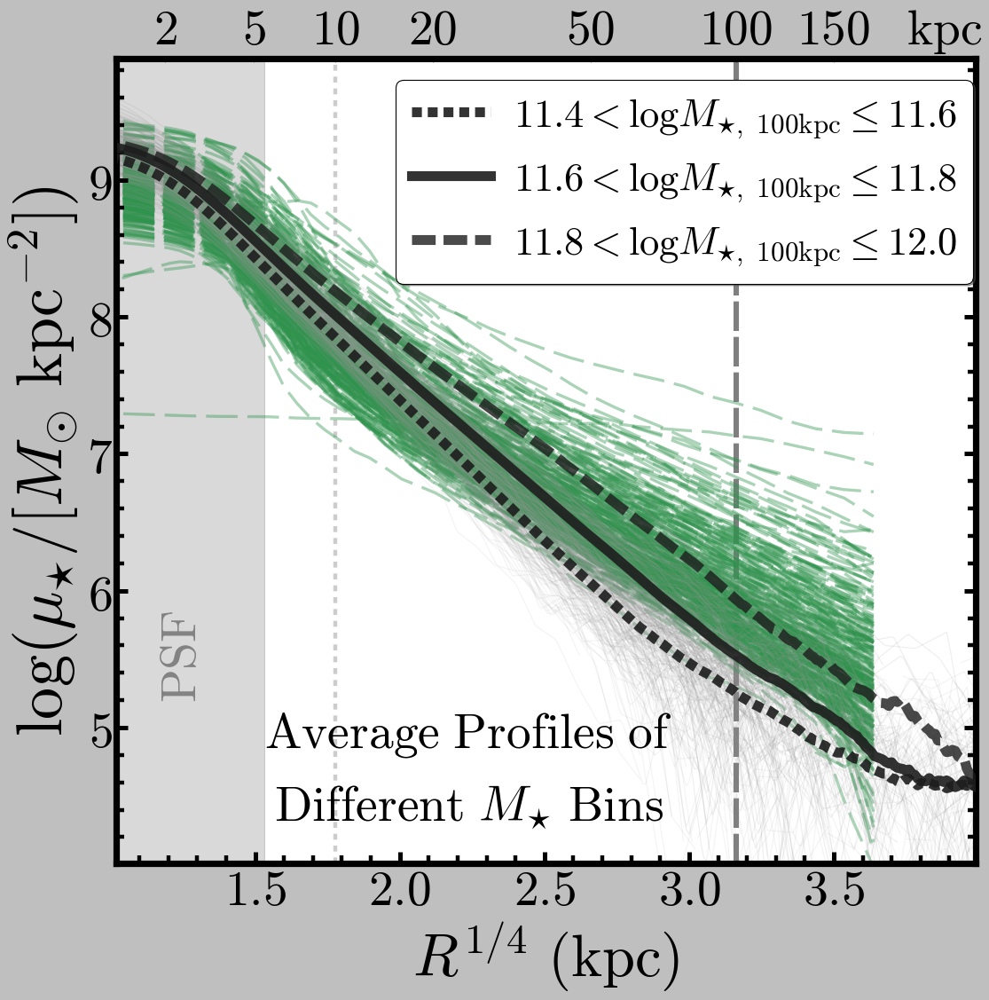

In [278]:
vline1, vline2 = 10.0, 100.0
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 3.99
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
showLegend = True
#-------------------------------------------------------------------------------#

label1="$11.4 < \log{M_{\star,\ 100\mathrm{kpc}}} \leq 11.6$"
label2="$11.6 < \log{M_{\star,\ 100\mathrm{kpc}}} \leq 11.8$"
label3="$11.8 < \log{M_{\star,\ 100\mathrm{kpc}}} \leq 12.0$"

showInfo1=True
showInfo2=True
showLegend=True
rPsfKpc=5.5
kpcArr=[2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 150.0]
color1a=BLK(0.5)
color1b=BLK(0.7)
cmap1=BLK
color2a=ORG(0.5)
color2b=ORG(0.7)
cmap2=ORG
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%g}\ $'
ytickFormat2='$\mathbf{%g}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(14, 14))
fig.subplots_adjust(left=0.13, right=0.995, 
                    bottom=0.13, top=0.94,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=50, xlabel=50, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)
# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax1.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax1.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax1.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax1.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
# --------------------------------------------------------------------------------------- #
## Individual profiles
for ii, aa in enumerate(rm0_sl):
    if (ii % 7) == 0:
        ax1.plot(RSMA_COMMON, aa, c=color1a, alpha=0.10, linewidth=1.1)
for ii, bb in enumerate(rm1_sl):
    if (ii % 7) == 0:
        ax1.plot(RSMA_COMMON, bb, c=color1a, alpha=0.15, linewidth=1.1)
for ii, cc in enumerate(rm2_sl):
    if (ii % 7) == 0:
        ax1.plot(RSMA_COMMON, cc, c=color1a, alpha=0.15, linewidth=1.1)
    
# --------------------------------------------------------------------------------------- #
## Median profiles
ax1.plot(RSMA_COMMON, rm0_aml[2], linestyle='--', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.9, zorder=8, label=label1, dashes=(10,6))

ax1.plot(RSMA_COMMON, rm1_aml[2], linestyle='-', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.9, zorder=8, label=label2)

ax1.plot(RSMA_COMMON, rm2_aml[2], linestyle='--', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.8, zorder=8, label=label3, dashes=(24,8))

# ========= #
for gal in cat:
    try:
        ax1.plot(gal['sma3'] ** 0.25, gal['sbp3a_prof'] + np.log10(h0square), linestyle='--', linewidth=3.0, 
                 c=GRN(0.7), alpha=0.4, zorder=0, dashes=(32,10))
    except Exception:
        pass
# ========= #

# --------------------------------------------------------------------------------------- #
## Y Lables
if norm:
    ax1.set_ylabel('$\mathrm{Normalized}\ \ \log ({\mu}_{\star}/[M_{\odot}\ \mathrm{kpc}^{-2}])$', 
                   size=41)
else:
    ax1.set_ylabel('$\log ({\mu}_{\star}/[M_{\odot}\ \mathrm{kpc}^{-2}])$', size=65)
    
ax1.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=60)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(xmin, xmax)
ax1.set_ylim(ymin, ymax)
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax - ymin) / 5.0
ax1.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin - ySep, ymin - ySep], 
                 [ymax + ySep, ymax + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
## Label the PSF region 
ax1.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax1.transAxes, weight='bold', 
         color='k', alpha=0.4)
# --------------------------------------------------------------------------------------- #
## Legend
if showLegend:
    ax1.legend(loc=(0.325, 0.72), shadow=True, fancybox=True, 
               numpoints=1, fontsize=40, scatterpoints=1, 
               markerscale=1.2, borderpad=0.4, handletextpad=0.6)
# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax2 = ax1.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax2.set_xlim(xmin, xmax)
ax2.set_xticks(kpcTicks)
ax2.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=50)
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
ax2.text(0.92, 1.0040, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax2.transAxes)
# --------------------------------------------------------------------------------------- #
ax1.text(0.41, 0.13, '$\mathrm{Average\ Profiles\ of}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=50.0, transform=ax1.transAxes)
ax1.text(0.41, 0.04, '$\mathrm{Different\ }M_{\star}\ \mathrm{Bins}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=50.0, transform=ax1.transAxes)
# --------------------------------------------------------------------------------------- #


# --------------------------------------------------------------------------------------- #

vline1, vline2 = 10.0, 100.0
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 3.99
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
showLegend = True

showInfo1=True
showInfo2=True
showLegend=True
rPsfKpc=5.5
kpcArr=[2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 150.0]
color1a=BLK(0.5)
color1b=BLK(0.7)
cmap1=BLK
color2a=ORG(0.5)
color2b=ORG(0.7)
cmap2=ORG
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%g}$'
ytickFormat2='$\mathbf{%g}$'

fig.savefig('mblack2_average_mass_profiles_ellipse1_z0.3.pdf', dpi=80)

plt.show()

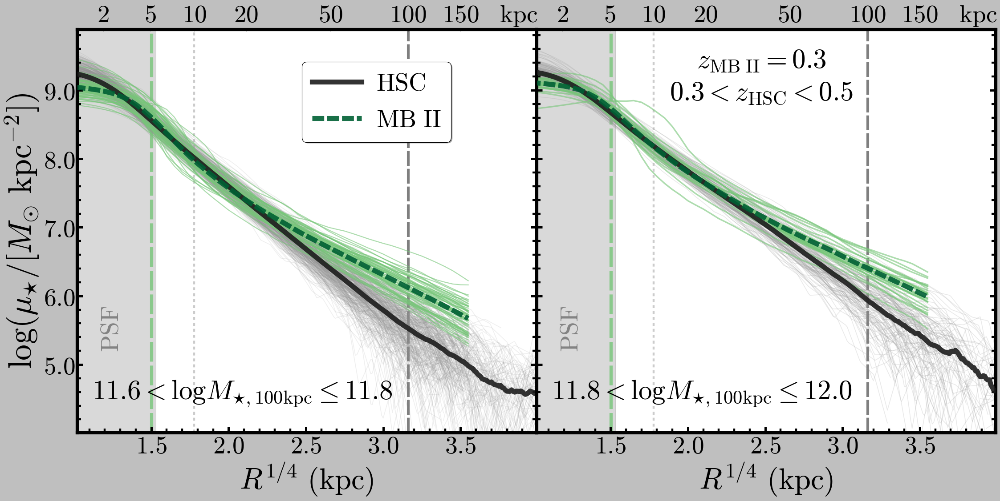

In [286]:
vline1, vline2 = 10.0, 100.0
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 3.99
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
showLegend = True
#-------------------------------------------------------------------------------#

label1="$\mathrm{HSC}$"
label2="$\mathrm{MB\ II}$"

label3="$11.4 < \log{M_{\star, 100\mathrm{kpc}}} \leq 11.6$"
label4="$11.6 < \log{M_{\star, 100\mathrm{kpc}}} \leq 11.8$"
label5="$11.8 < \log{M_{\star, 100\mathrm{kpc}}} \leq 12.0$"

label6="$0.3 < z_{\mathrm{HSC}} < 0.5$"
label7="$z_{\mathrm{MB\ II}}=0.3$"

showInfo1=True
showInfo2=True
showLegend=True
rPsfKpc=5.5
kpcArr=[2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 150.0]
color1a=BLK(0.5)
color1b=BLK(0.7)
cmap1=BLK
color2a=GRN(0.5)
color2b=GRN(0.7)
cmap2=GRN
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}\ $'
ytickFormat2='$\mathbf{%g}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(28.5, 14))
fig.subplots_adjust(left=0.09, right=0.995, 
                    bottom=0.13, top=0.94,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #


# --------------------------------------------------------------------------------------- #
ax3 = fig.add_subplot(121)
ax3 = songPlotSetup(ax3, ylabel=50, xlabel=50, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax3.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax3.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax3.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax3.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
    
ax3.axvline((scale * 2.5) ** 0.25, linewidth=6.5, c=GRN(0.5), linestyle='--', dashes=(40,8),
            zorder=0, alpha=0.8)
# --------------------------------------------------------------------------------------- #
## Individual profiles
for ii, aa in enumerate(rm1_sl):
    if (ii % 2) == 0:
        ax3.plot(RSMA_COMMON, aa, c=color1a, alpha=0.15, linewidth=1.5)
        
for ii, aa in enumerate(bMProf1B):
    ax3.plot(RSMA_SIM, aa + np.log10(h0square), c=color2a, alpha=0.60, linewidth=2.0)
    
# --------------------------------------------------------------------------------------- #
## Median profiles
ax3.plot(RSMA_COMMON, rm1_aml[2], linestyle='-', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.9, zorder=8, label=label1)

ax3.plot(RSMA_SIM, bAvgProf1B[2] + np.log10(h0square), linestyle='--', linewidth=10.0, 
         c=cmap2(0.9), alpha=0.9, zorder=8, dashes=(24,6), label=label2)

# --------------------------------------------------------------------------------------- #
## Y Lables
ax3.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=60)
ax3.set_ylabel('$\log ({\mu}_{\star}/[M_{\odot}\ \mathrm{kpc}^{-2}])$', size=65)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax3.set_xlim(xmin, xmax)
ax3.set_ylim(ymin, ymax)
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax - ymin) / 5.0
ax3.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin - ySep, ymin - ySep], 
                 [ymax + ySep, ymax + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
## Label the PSF region 
ax3.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax3.transAxes, weight='bold', 
         color='k', alpha=0.4)

## Legend
ax3.legend(loc=(0.49, 0.720), shadow=True, fancybox=True, 
           numpoints=1, fontsize=50, scatterpoints=1, 
           markerscale=1.2, borderpad=0.4, handletextpad=0.6)

# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax4 = ax3.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax4.set_xlim(xmin, xmax)
ax4.set_xticks(kpcTicks)
ax4.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=50)
for tick in ax4.xaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
for tick in ax4.yaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
ax4.text(0.92, 1.0040, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax4.transAxes)
# --------------------------------------------------------------------------------------- #
ax3.text(0.36, 0.06, label4,
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax3.transAxes)
# --------------------------------------------------------------------------------------- #

# --------------------------------------------------------------------------------------- #
ax5 = fig.add_subplot(122)
ax5 = songPlotSetup(ax5, ylabel=50, xlabel=50, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax5.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax5.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax5.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax5.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
    
ax5.axvline((scale * 2.5) ** 0.25, linewidth=6.5, c=GRN(0.5), linestyle='--', dashes=(40,8),
            zorder=0, alpha=0.8)
    
# --------------------------------------------------------------------------------------- #
## Individual profiles
for ii, aa in enumerate(rm2_sl):
    ax5.plot(RSMA_COMMON, aa, c=color1a, alpha=0.20, linewidth=1.5)
        
for ii, aa in enumerate(bMProf2B):
    ax5.plot(RSMA_SIM, aa + np.log10(h0square), c=color2a, alpha=0.60, linewidth=3.0)
    
# --------------------------------------------------------------------------------------- #
## Median profiles
ax5.plot(RSMA_COMMON, rm2_aml[2], linestyle='-', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.9, zorder=8, label=label3)

ax5.plot(RSMA_SIM, bAvgProf2B[2] + np.log10(h0square), linestyle='--', linewidth=10.0, 
         c=cmap2(0.9), alpha=0.9, zorder=8, label=label6, dashes=(24,6))

# --------------------------------------------------------------------------------------- #
## Y Lables
ax5.yaxis.set_major_formatter(NullFormatter())
ax5.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=60)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax5.set_xlim(xmin, xmax)
ax5.set_ylim(ymin, ymax)
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax - ymin) / 5.0
ax5.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin - ySep, ymin - ySep], 
                 [ymax + ySep, ymax + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
## Label the PSF region 
ax5.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax5.transAxes, weight='bold', 
         color='k', alpha=0.4)

# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax6 = ax5.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax6.set_xlim(xmin, xmax)
ax6.set_xticks(kpcTicks)
ax6.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=50)
for tick in ax6.xaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
for tick in ax6.yaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
ax6.text(0.92, 1.0040, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax6.transAxes)
# --------------------------------------------------------------------------------------- #
ax5.text(0.49, 0.89, label7,
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax5.transAxes)
ax5.text(0.49, 0.81, label6,
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax5.transAxes)
# --------------------------------------------------------------------------------------- #
ax5.text(0.36, 0.06, label5,
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax5.transAxes)
# --------------------------------------------------------------------------------------- #

fig.savefig(os.path.join('mblack2_mass_prof_1b.pdf'), dpi=90)

plt.show()

## Plot the mass curve of growth

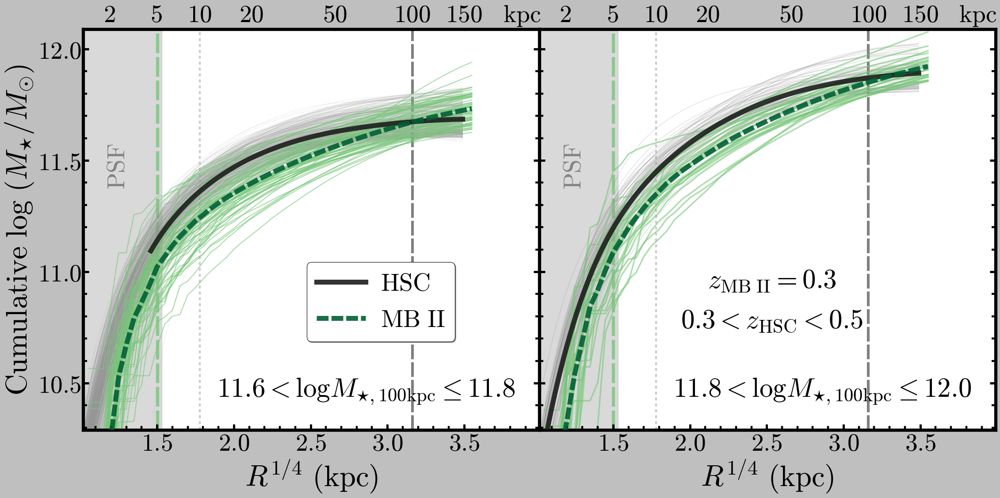

In [285]:
vline1, vline2 = 10.0, 100.0
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 3.99
#-------------------------------------------------------------------------------#
ymin, ymax = 10.29, 12.09
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
showLegend = True
#-------------------------------------------------------------------------------#

label1="$\mathrm{HSC}$"
label2="$\mathrm{MB\ II}$"

label3="$11.4 < \log{M_{\star, 100\mathrm{kpc}}} \leq 11.6$"
label4="$11.6 < \log{M_{\star, 100\mathrm{kpc}}} \leq 11.8$"
label5="$11.8 < \log{M_{\star, 100\mathrm{kpc}}} \leq 12.0$"

label6="$0.3 < z_{\mathrm{HSC}} < 0.5$"
label7="$z_{\mathrm{MB\ II}}=0.3$"

showInfo1=True
showInfo2=True
showLegend=True
rPsfKpc=5.5
kpcArr=[2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 150.0]
color1a=BLK(0.5)
color1b=BLK(0.7)
cmap1=BLK
color2a=GRN(0.5)
color2b=GRN(0.7)
cmap2=GRN
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}\ $'
ytickFormat2='$\mathbf{%g}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(28.5, 14))
fig.subplots_adjust(left=0.09, right=0.995, 
                    bottom=0.13, top=0.94,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #


# --------------------------------------------------------------------------------------- #
ax3 = fig.add_subplot(121)
ax3 = songPlotSetup(ax3, ylabel=50, xlabel=50, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax3.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax3.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax3.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax3.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
    
ax3.axvline((scale * 2.5) ** 0.25, linewidth=6.5, c=GRN(0.5), linestyle='--', dashes=(40,8),
            zorder=0, alpha=0.8)

# --------------------------------------------------------------------------------------- #
## Individual profiles
for ii, aa in enumerate(cogS1a):
    if (ii % 2) == 0:
        ax3.plot(RSMA_COG, aa, c=color1a, alpha=0.15, linewidth=1.1)
        
for ii, aa in enumerate(bCProf1B):
    ax3.plot(RSMA_SIM, aa - np.log10(h0), c=color2a, alpha=0.60, linewidth=2.0)
    
# --------------------------------------------------------------------------------------- #
## Median profiles
ax3.plot(RSMA_COG, cogA1a[2], linestyle='-', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.9, zorder=8, label=label1)

ax3.plot(RSMA_SIM, bAvgCProf1B - np.log10(h0), linestyle='--', linewidth=10.0, 
         c=cmap2(0.9), alpha=0.9, zorder=8, dashes=(24,6), label=label2)

# --------------------------------------------------------------------------------------- #
## Y Lables
ax3.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=60)
ax3.set_ylabel('$\mathrm{Cumulative\ }\log\ (M_{\star}/M_{\odot})$', size=60)

# --------------------------------------------------------------------------------------- #
## X, Y limits
ax3.set_xlim(xmin, xmax)
ax3.set_ylim(ymin, ymax)
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax - ymin) / 5.0
ax3.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin - ySep, ymin - ySep], 
                 [ymax + ySep, ymax + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
## Label the PSF region 
ax3.text(0.05, 0.60, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax3.transAxes, weight='bold', 
         color='k', alpha=0.4)

## Legend
ax3.legend(loc=(0.49, 0.220), shadow=True, fancybox=True, 
           numpoints=1, fontsize=50, scatterpoints=1, 
           markerscale=1.2, borderpad=0.4, handletextpad=0.6)

# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax4 = ax3.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax4.set_xlim(xmin, xmax)
ax4.set_xticks(kpcTicks)
ax4.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=50)
for tick in ax4.xaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
for tick in ax4.yaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
ax4.text(0.92, 1.0040, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax4.transAxes)
# --------------------------------------------------------------------------------------- #
ax3.text(0.62, 0.06, label4,
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax3.transAxes)
# --------------------------------------------------------------------------------------- #

# --------------------------------------------------------------------------------------- #
ax5 = fig.add_subplot(122)
ax5 = songPlotSetup(ax5, ylabel=50, xlabel=50, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax5.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax5.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax5.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax5.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
    
ax5.axvline((scale * 2.5) ** 0.25, linewidth=6.5, c=GRN(0.5), linestyle='--', dashes=(40,8),
            zorder=0, alpha=0.8)

# --------------------------------------------------------------------------------------- #
## Individual profiles
for ii, aa in enumerate(cogS2a):
    if (ii % 2) == 0:
        ax5.plot(RSMA_COG, aa, c=color1a, alpha=0.25, linewidth=1.5)
        
for ii, aa in enumerate(bCProf2B):
    ax5.plot(RSMA_SIM, aa - np.log10(h0), c=color2a, alpha=0.60, linewidth=3.0)
    
# --------------------------------------------------------------------------------------- #
## Median profiles
ax5.plot(RSMA_COG, cogA2a[2], linestyle='-', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.9, zorder=8, label=label1)

ax5.plot(RSMA_SIM, bAvgCProf2B - np.log10(h0), linestyle='--', linewidth=10.0, 
         c=cmap2(0.9), alpha=0.9, zorder=8, dashes=(24,6), label=label2)
    
# --------------------------------------------------------------------------------------- #
## Y Lables
ax5.yaxis.set_major_formatter(NullFormatter())
ax5.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=60)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax5.set_xlim(xmin, xmax)
ax5.set_ylim(ymin, ymax)
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax - ymin) / 5.0
ax5.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin - ySep, ymin - ySep], 
                 [ymax + ySep, ymax + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
## Label the PSF region 
ax5.text(0.05, 0.60, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax5.transAxes, weight='bold', 
         color='k', alpha=0.4)

# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax6 = ax5.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax6.set_xlim(xmin, xmax)
ax6.set_xticks(kpcTicks)
ax6.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=50)
for tick in ax6.xaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
for tick in ax6.yaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
ax6.text(0.92, 1.0040, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax6.transAxes)
# --------------------------------------------------------------------------------------- #
ax5.text(0.51, 0.34, label7,
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax5.transAxes)
ax5.text(0.51, 0.24, label6,
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax5.transAxes)

# --------------------------------------------------------------------------------------- #
ax5.text(0.62, 0.06, label5,
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax5.transAxes)
# --------------------------------------------------------------------------------------- #

fig.savefig(os.path.join('mblack2_z0.30_cog_1b.pdf'), dpi=90)

plt.show()

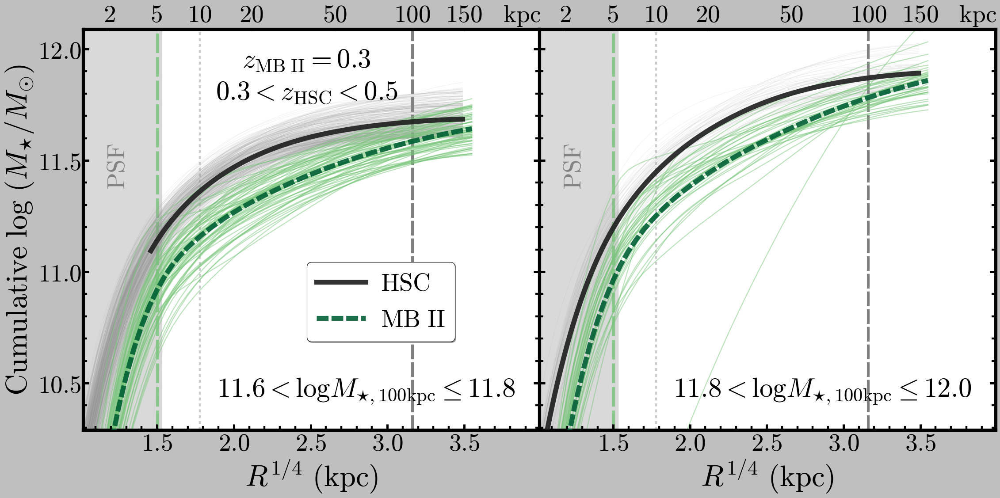

In [160]:
vline1, vline2 = 10.0, 100.0
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 3.99
#-------------------------------------------------------------------------------#
ymin, ymax = 10.29, 12.09
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
showLegend = True
#-------------------------------------------------------------------------------#

label1="$\mathrm{HSC}$"
label2="$\mathrm{MB\ II}$"

label3="$11.4 < \log{M_{\star, 100\mathrm{kpc}}} \leq 11.6$"
label4="$11.6 < \log{M_{\star, 100\mathrm{kpc}}} \leq 11.8$"
label5="$11.8 < \log{M_{\star, 100\mathrm{kpc}}} \leq 12.0$"

label6="$0.3 < z_{\mathrm{HSC}} < 0.5$"
label7="$z_{\mathrm{MB\ II}}=0.3$"

showInfo1=True
showInfo2=True
showLegend=True
rPsfKpc=5.5
kpcArr=[2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 150.0]
color1a=BLK(0.5)
color1b=BLK(0.7)
cmap1=BLK
color2a=GRN(0.5)
color2b=GRN(0.7)
cmap2=GRN
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}\ $'
ytickFormat2='$\mathbf{%g}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(28.5, 14))
fig.subplots_adjust(left=0.09, right=0.995, 
                    bottom=0.13, top=0.94,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #


# --------------------------------------------------------------------------------------- #
ax3 = fig.add_subplot(121)
ax3 = songPlotSetup(ax3, ylabel=50, xlabel=50, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax3.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax3.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax3.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax3.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
    
ax3.axvline((scale * 2.5) ** 0.25, linewidth=6.5, c=GRN(0.5), linestyle='--', dashes=(40,8),
            zorder=0, alpha=0.8)

# --------------------------------------------------------------------------------------- #
## Individual profiles
for ii, aa in enumerate(cogS1a):
    if (ii % 2) == 0:
        ax3.plot(RSMA_COG, aa, c=color1a, alpha=0.10, linewidth=1.1)
        
for ii, aa in enumerate(bCProf1A):
    ax3.plot(RSMA_SIM, aa, c=color2a, alpha=0.50, linewidth=2.0)
    
# --------------------------------------------------------------------------------------- #
## Median profiles
ax3.plot(RSMA_COG, cogA1a[2], linestyle='-', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.9, zorder=8, label=label1)

ax3.plot(RSMA_SIM, bAvgCProf1A, linestyle='--', linewidth=10.0, 
         c=cmap2(0.9), alpha=0.9, zorder=8, dashes=(24,6), label=label2)

# --------------------------------------------------------------------------------------- #
## Y Lables
ax3.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=60)
ax3.set_ylabel('$\mathrm{Cumulative\ }\log\ (M_{\star}/M_{\odot})$', size=60)

# --------------------------------------------------------------------------------------- #
## X, Y limits
ax3.set_xlim(xmin, xmax)
ax3.set_ylim(ymin, ymax)
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax - ymin) / 5.0
ax3.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin - ySep, ymin - ySep], 
                 [ymax + ySep, ymax + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
## Label the PSF region 
ax3.text(0.05, 0.60, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax3.transAxes, weight='bold', 
         color='k', alpha=0.4)

## Legend
ax3.legend(loc=(0.49, 0.220), shadow=True, fancybox=True, 
           numpoints=1, fontsize=50, scatterpoints=1, 
           markerscale=1.2, borderpad=0.4, handletextpad=0.6)

# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax4 = ax3.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax4.set_xlim(xmin, xmax)
ax4.set_xticks(kpcTicks)
ax4.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=50)
for tick in ax4.xaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
for tick in ax4.yaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
ax4.text(0.92, 1.0040, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax4.transAxes)
# --------------------------------------------------------------------------------------- #
ax3.text(0.62, 0.06, label4,
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax3.transAxes)
# --------------------------------------------------------------------------------------- #

# --------------------------------------------------------------------------------------- #
ax5 = fig.add_subplot(122)
ax5 = songPlotSetup(ax5, ylabel=50, xlabel=50, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax5.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax5.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax5.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax5.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
    
ax5.axvline((scale * 2.5) ** 0.25, linewidth=6.5, c=GRN(0.5), linestyle='--', dashes=(40,8),
            zorder=0, alpha=0.8)

# --------------------------------------------------------------------------------------- #
## Individual profiles
for ii, aa in enumerate(cogS2a):
    if (ii % 2) == 0:
        ax5.plot(RSMA_COG, aa, c=color1a, alpha=0.10, linewidth=1.1)
        
for ii, aa in enumerate(bCProf2A):
    ax5.plot(RSMA_SIM, aa, c=color2a, alpha=0.50, linewidth=2.0)
    
# --------------------------------------------------------------------------------------- #
## Median profiles
ax5.plot(RSMA_COG, cogA2a[2], linestyle='-', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.9, zorder=8, label=label1)

ax5.plot(RSMA_SIM, bAvgCProf2A, linestyle='--', linewidth=10.0, 
         c=cmap2(0.9), alpha=0.9, zorder=8, dashes=(24,6), label=label2)
    
# --------------------------------------------------------------------------------------- #
## Y Lables
ax5.yaxis.set_major_formatter(NullFormatter())
ax5.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=60)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax5.set_xlim(xmin, xmax)
ax5.set_ylim(ymin, ymax)
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax - ymin) / 5.0
ax5.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin - ySep, ymin - ySep], 
                 [ymax + ySep, ymax + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
## Label the PSF region 
ax5.text(0.05, 0.60, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax5.transAxes, weight='bold', 
         color='k', alpha=0.4)

# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax6 = ax5.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax6.set_xlim(xmin, xmax)
ax6.set_xticks(kpcTicks)
ax6.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=50)
for tick in ax6.xaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
for tick in ax6.yaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
ax6.text(0.92, 1.0040, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax6.transAxes)
# --------------------------------------------------------------------------------------- #
ax3.text(0.49, 0.89, label7,
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax3.transAxes)
ax3.text(0.49, 0.81, label6,
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax3.transAxes)

# --------------------------------------------------------------------------------------- #
ax5.text(0.62, 0.06, label5,
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax5.transAxes)
# --------------------------------------------------------------------------------------- #

fig.savefig(os.path.join('mblack2_z0.30_cog_1a.pdf'), dpi=90)

plt.show()

## Compare the ellipticity profile

In [136]:
profSample1, profSample2 = nonbcgProfM100c, redbcgProfM100c
outPng = sampleM100c
figDir = figDir
save = True
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 3.15
ymin1, ymax1 = 0.02, 0.69
norm, integrate, normR1 = False, False, 10.0
rsma0 = 1.02
rsma1 = 3.45
#-------------------------------------------------------------------------------#
indEll1, indEll2 = 0.9, 3.8
indColor1, indColor2 = 0.9, 3.9
colG, colR, colI, colZ = 'muG1', 'muR1', 'muI1', 'muZ1'
colEll = 'ell'
xtickFormat, ytickFormat, ytickFormat2 = '$\mathbf{%3.1f}$', '$\mathbf{%3.1f}$', '$\mathbf{%3.1f}$'
highlight1, highlight2 = True, True
vline1, vline2 = 10.0, 100.0
rPsfKpc = 6.1
cmap1, cmap2, cmap3 = BLK, ORG, BLU
alpha1, alpha2 = 0.5, 0.5
compareOthers = True
showLegend = True
xLegend1, yLegend1 = 0.05, 0.60
xLegend2, yLegend2 = 0.05, 0.65
xLegend3, yLegend3 = 0.05, 0.08
#-------------------------------------------------------------------------------#

#### ELLIPTICITY PROFILES ####
indEllip = np.intersect1d(np.where(RSMA_COMMON >= indEll1)[0], 
                          np.where(RSMA_COMMON <= indEll2)[0])

# GAMA M1a 
gm_se, gm_me, gm_ae, gm_de = organizeSbp(profSample1, col1=colEll, col2=None, 
                                         kind='sbp', index=indEllip)
# BCG M1a 
bm_se, bm_me, bm_ae, bm_de = organizeSbp(profSample2, col1=colEll, col2=None, 
                                         kind='sbp', index=indEllip)

#### COLOR PROFILES ####
indColor= np.intersect1d(np.where(RSMA_COMMON >= indColor1)[0], 
                         np.where(RSMA_COMMON <= indColor2)[0])

## NO KCORRECTION APPLIED !!
## NO KCORRECTION APPLIED !!


/usr/local/lib/python2.7/site-packages/matplotlib/axes/_axes.py:545: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


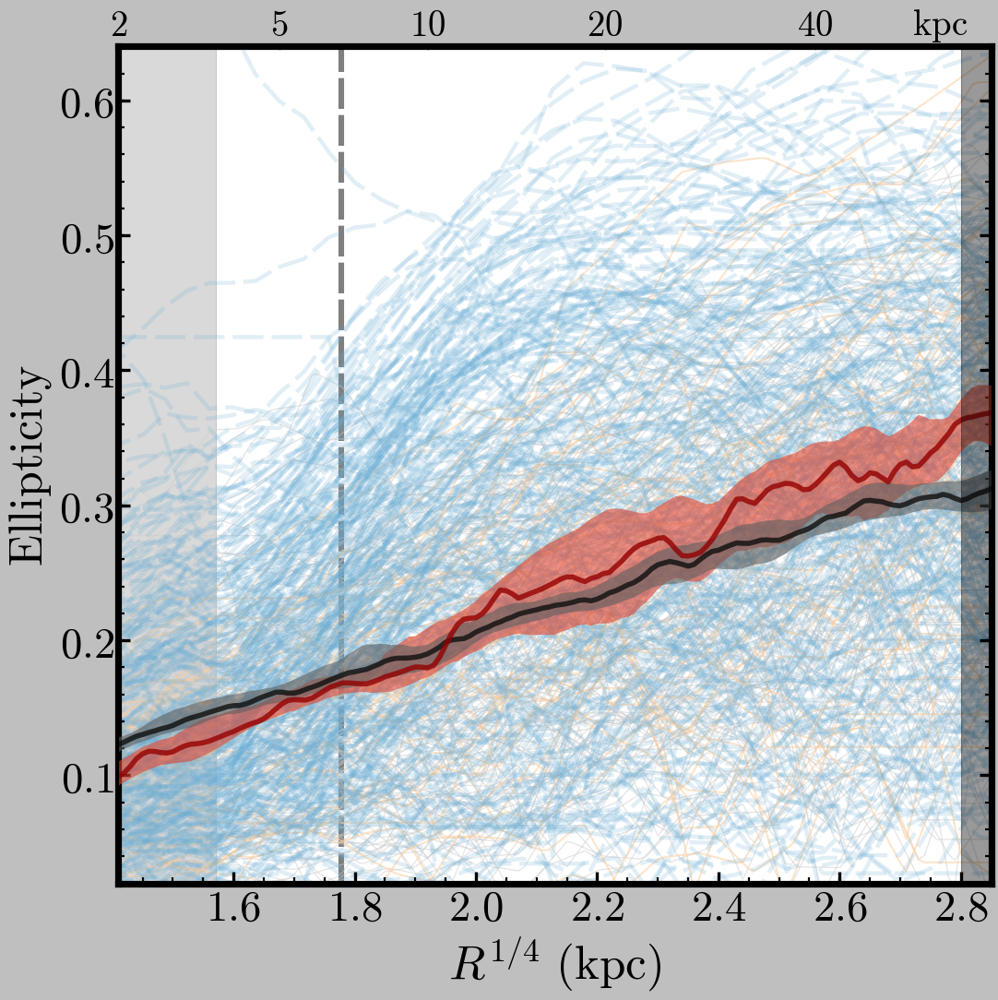

In [137]:
# --------------------------------------------------------------------------------------- #
xmin, xmax =  1.41, 2.85
ymin1, ymax1 = 0.02, 0.64
norm, integrate, normR1 = False, False, 10.0
rsma0 = 1.41
rsma1 = 2.85
kpcArr = [2.0, 5.0, 10.0, 20.0, 40.0]

## Setup up figure
fig = plt.figure(figsize=(14, 14))
fig.subplots_adjust(left=0.15, right=0.995, 
                    bottom=0.13, top=0.94,
                    wspace=0.00, hspace=0.00)

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=42, xlabel=42, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)
# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax1.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax1.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax1.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax1.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
# --------------------------------------------------------------------------------------- #

# --------------------------------------------------------------------------------------- #
# ELLIPTICITY PLOT
# --------------------------------------------------------------------------------------- #
## Horiozontal 0.0 line
ax1.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax1 - ymin1) / 5.0
ax1.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin1 - ySep, ymin1 - ySep], 
                 [ymax1 + ySep, ymax1 + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
## Region affected by Sky
ax1.fill_between([2.8, 4.15], 
                 [ymin1 - ySep, ymin1 - ySep], 
                 [ymax1 + ySep, ymax1 + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.40, zorder=1000)
# --------------------------------------------------------------------------------------- #
## Individual profiles
for i, gg in enumerate(gm_se):
    if np.nanmax(gg[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], gg, c=cmap1(0.3), alpha=alpha1, linewidth=1.2)
    else:
        np.delete(gm_se, i)
        
for j, bb in enumerate(bm_se):
    if np.nanmax(bb[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], bb, c=cmap2(0.3), alpha=alpha2, linewidth=1.8)
    else:
        np.delete(bm_se, j)
# --------------------------------------------------------------------------------------- #
## Smoothed median profiles 
gm_low = convolve(gm_me[0], Box1DKernel(5))    
gm_upp = convolve(gm_me[1], Box1DKernel(5)) 
gm_med = convolve(gm_me[2], Box1DKernel(3))

bm_low = convolve(bm_me[0], Box1DKernel(5))    
bm_upp = convolve(bm_me[1], Box1DKernel(5)) 
bm_med = convolve(bm_me[2], Box1DKernel(3))
        
ax1.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=cmap2(0.7), edgecolor='none', alpha=0.6, zorder=5)
ax1.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=cmap1(0.7), edgecolor='none', alpha=0.6, zorder=6)

ax1.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=cmap1(0.95), alpha=0.8, zorder=7)
ax1.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=cmap2(0.95), alpha=0.8, zorder=8)

# --------------------------------------------------------------------------------------- #
for gal in cat: 
    try:
        ax1.plot(gal['sma2'] ** 0.25, gal['ell_prof'], linestyle='--', c=BLU(0.5), 
                 linewidth=4.0, alpha=0.2, zorder=2, dashes=(30, 8))
    except Exception:
        pass
# --------------------------------------------------------------------------------------- #

# --------------------------------------------------------------------------------------- #
## Legend
ax1.legend(loc=(xLegend1, yLegend1), shadow=True, fancybox=True, 
           numpoints=1, fontsize=32, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)
# --------------------------------------------------------------------------------------- #
## Label
ax1.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=46)
ax1.set_ylabel('$\mathrm{Ellipticity}$', size=45)
# --------------------------------------------------------------------------------------- #
## X, Y, Limit
ax1.set_xlim(rsma0, rsma1)
ax1.set_ylim(ymin1, ymax1)
# --------------------------------------------------------------------------------------- #
## Remove the X-axis label
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')
# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax1b = ax1.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax1b.set_xlim(xmin, xmax)
ax1b.set_xticks(kpcTicks)
ax1b.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=35)
for tick in ax1b.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1b.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax1b.text(0.91, 1.0035, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=35.0, transform=ax1b.transAxes)
# --------------------------------------------------------------------------------------- #
plt.show()

fig.savefig('mblack2_ellp_prof_z0.3.pdf', dpi=120)

In [302]:
catC = copy.deepcopy(catUse)

catC.remove_columns(['sma2', 'ell_prof', 'pa_prof', 'sbp2_prof',
                     'sma3', 'sbp3a_prof', 'cog3a_prof', 'sbp3b_prof', 'cog3b_prof'])

catC.write('mblack2_logm11.4_z0.3_ellip3.fits', format='fits', overwrite=True)